<a href="https://colab.research.google.com/github/oFirEStorMo/GobhirShikha/blob/main/curriculum1_residual_autoencoder_mse_cosine_lr_001.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToTensor
from PIL import Image
import os
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/Data/data.zip -d /content/dataset
!unzip /content/drive/MyDrive/Data/test_data.zip -d /content/dataset

In [2]:
class CustomDataset(Dataset):
    # Define the custom dataset class
    def __init__(self, input_dir, output_dir, transform=None):
        self.input_dir = input_dir
        self.output_dir = output_dir
        self.transform = transform
        self.input_files = os.listdir(input_dir)

    def __len__(self):
        return len(self.input_files)

    def __getitem__(self, idx):
        input_filename = self.input_files[idx]
        input_path = os.path.join(self.input_dir, input_filename)
        output_path = os.path.join(self.output_dir, input_filename)
        input_image = Image.open(input_path).convert('RGB')
        output_image = Image.open(output_path).convert('RGB')

        if self.transform:
            input_image = self.transform(input_image)
            output_image = self.transform(output_image)

        return input_image, output_image

In [3]:
class IdentityBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(IdentityBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        # out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        # out = self.bn2(out)

        out += identity
        # out = self.relu(out)

        return out


class ConvolutionalBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=2):
        super(ConvolutionalBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.conv3 = nn.Conv2d(out_channels, out_channels, kernel_size=1, stride=1)
        self.bn3 = nn.BatchNorm2d(out_channels)
        self.downsample = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride),
            nn.BatchNorm2d(out_channels)
        )

    def forward(self, x):
        identity = self.downsample(x)

        out = self.conv1(x)
        # out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        # out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        out += identity
        # out = self.relu(out)

        return out

class DeconvolutionalBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=2):
        super(DeconvolutionalBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=stride, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.ConvTranspose2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.conv3 = nn.ConvTranspose2d(out_channels, out_channels, kernel_size=1, stride=1)
        self.bn3 = nn.BatchNorm2d(out_channels)
        self.downsample = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=stride, padding=1),
            nn.BatchNorm2d(out_channels)
        )

    def forward(self, x):
        identity = self.downsample(x)

        out = self.conv1(x)
        # out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        # out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        out += identity
        # out = self.relu(out)

        return out

class Autoencoder(nn.Module):
    def __init__(self, input_shape=(224, 224, 3)):
        super(Autoencoder, self).__init__()
        self.input_shape = input_shape
        self.encoder = self.build_encoder()
        self.decoder = self.build_decoder()
        self.autoencoder = self.build_autoencoder()

    def build_encoder(self):
        model = nn.Sequential(
            ConvolutionalBlock(3, 64),
            nn.ReLU(),
            IdentityBlock(64,64),
            nn.ReLU(),
            ConvolutionalBlock(64,128, stride=1),
            nn.ReLU(),
            ConvolutionalBlock(128, 128),
            nn.ReLU(),
            ConvolutionalBlock(128, 256),
            nn.ReLU(),
            # ConvolutionalBlock(256, 256),
            # nn.ReLU(),
            ConvolutionalBlock(256,512, stride=1),
            nn.ReLU(),
            IdentityBlock(512,512),
            nn.ReLU(),
            ConvolutionalBlock(512,256, stride=1),
            nn.ReLU(),
        )
        return model

    def build_decoder(self):
        model = nn.Sequential(
            # ConvolutionalBlock(256, 128, stride=1),
            # nn.ReLU(),
            DeconvolutionalBlock(256, 128, 2),
            # ConvolutionalBlock(128, 64, stride=1),
            nn.ReLU(),
            DeconvolutionalBlock(128, 64, 2),
            # ConvolutionalBlock(64, 32, stride=1),
            nn.ReLU(),
            # DeconvolutionalBlock(64, 32, 2),
            ConvolutionalBlock(64, 32, stride=1),
            nn.ReLU(),
            DeconvolutionalBlock(32, 3, 2),
            nn.Sigmoid()
        )
        return model

    def build_autoencoder(self):
        return nn.Sequential(self.encoder, self.decoder)

    def forward(self, x):
        return self.autoencoder(x)

In [4]:
test_model = Autoencoder()
test_output = test_model(torch.rand(1,3,224,224))
print(test_output.shape)

torch.Size([1, 3, 224, 224])


In [5]:
!pip install pytorch-msssim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [6]:
from pytorch_msssim import SSIM,MS_SSIM
calculate_msssim_score = MS_SSIM(data_range=1, size_average=True, channel=3)

In [7]:
calculate_mse_loss = nn.MSELoss()

In [8]:
# ssim_module = MS_SSIM(data_range=1, size_average=True, channel=3)
def direction_aware_dist(
    x1: torch.Tensor,
    x2: torch.Tensor,
    alpha: float = 1,
    beta: float = 1
) -> torch.Tensor:
    """Returns the direction-aware distance between `x1` and `x2`.

    :param x1: (torch.Tensor) First input (batch_size, dim)
    :param x2: (torch.Tensor) Second input (batch_size, dim)
    :return: (torch.Tensor) Direction-aware distance between `x1` and `x2` (batch_size, 1)
    """
    x1 = x1.flatten(start_dim=1)
    x2 = x2.flatten(start_dim=1)
    euclid_dist_sq_mean = (x1 - x2).square().mean(dim=1, keepdim=True)
    cosine_dist = 1 - torch.cosine_similarity(x1, x2).unsqueeze(dim=1)
    distance = torch.sqrt(alpha * euclid_dist_sq_mean + beta * cosine_dist)
    return distance.mean()



In [9]:
def criterion(output, input):
  return direction_aware_dist(output, input)

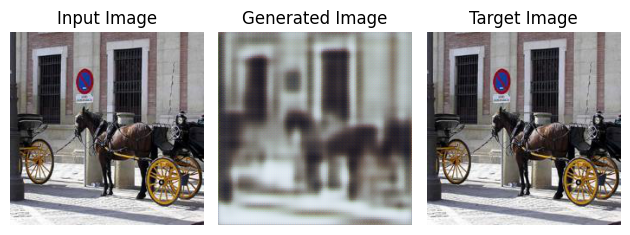

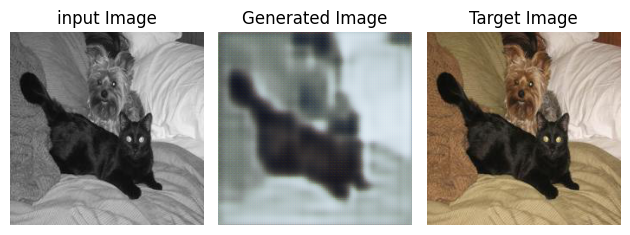

Epoch [1/100], Loss: 0.2326
Validation Loss: 0.2723


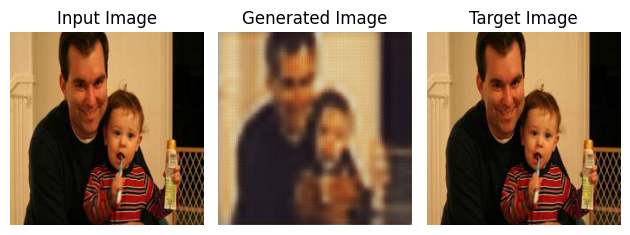

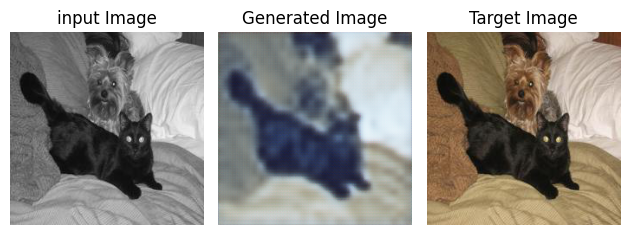

Epoch [2/100], Loss: 0.2201
Validation Loss: 0.2620


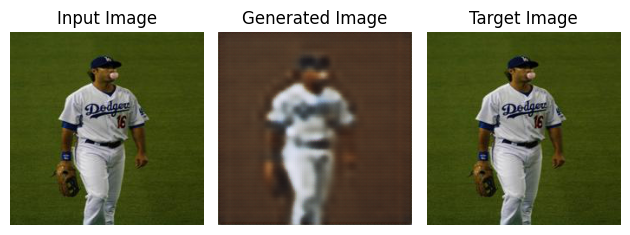

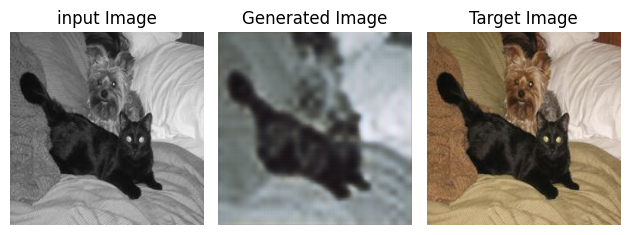

Epoch [3/100], Loss: 0.1883
Validation Loss: 0.2261


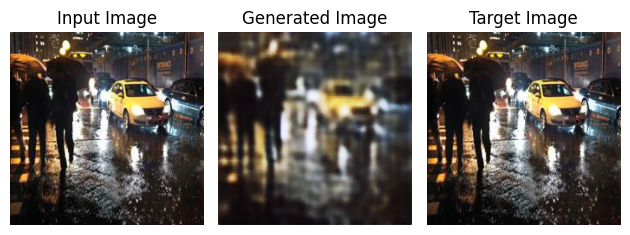

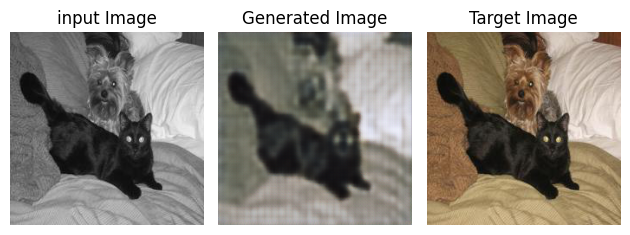

Epoch [4/100], Loss: 0.1459
Validation Loss: 0.2051


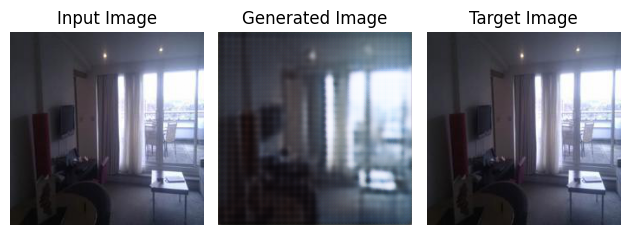

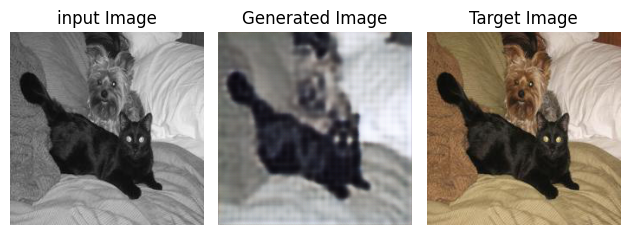

Epoch [5/100], Loss: 0.1755
Validation Loss: 0.2142


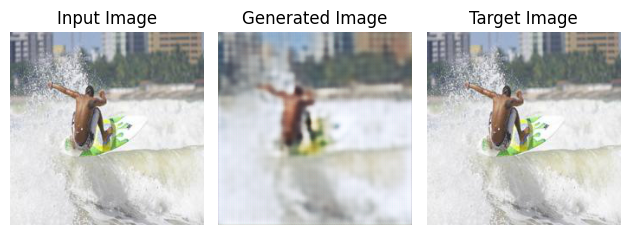

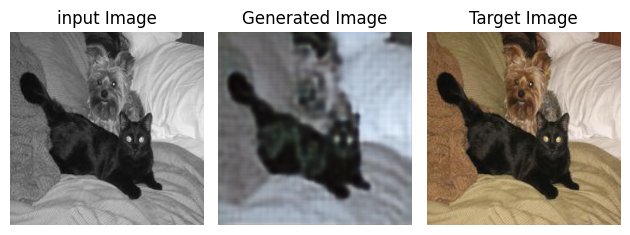

Epoch [6/100], Loss: 0.1843
Validation Loss: 0.2096


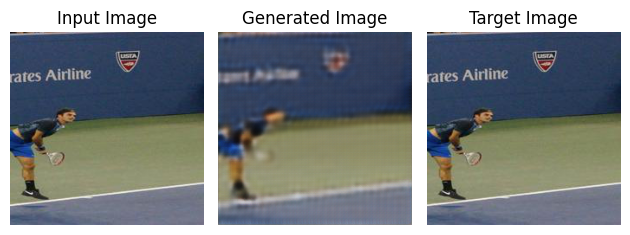

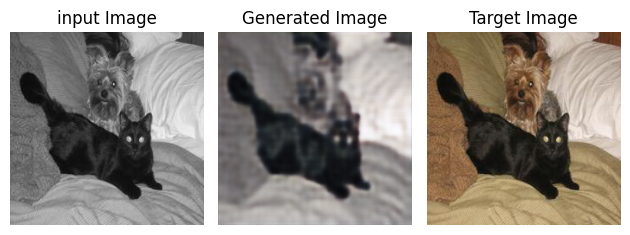

Epoch [7/100], Loss: 0.1550
Validation Loss: 0.2007


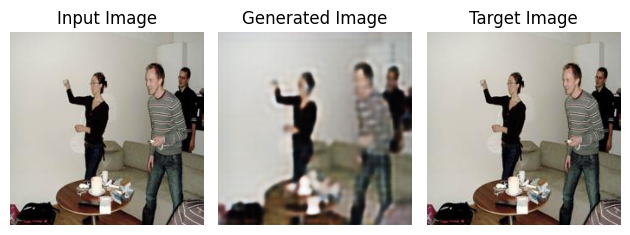

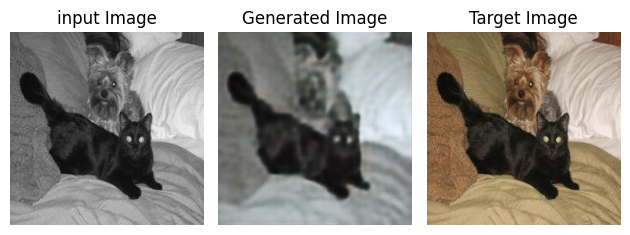

Epoch [8/100], Loss: 0.1691
Validation Loss: 0.1999


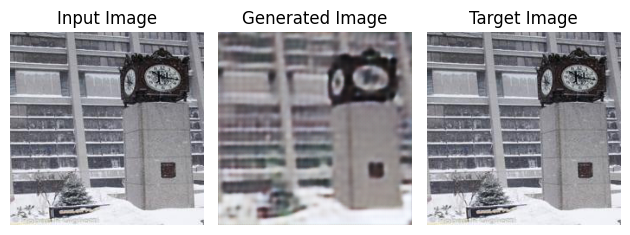

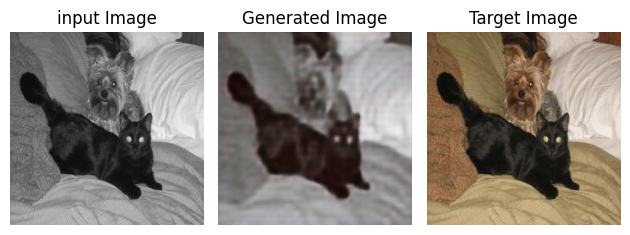

Epoch [9/100], Loss: 0.1530
Validation Loss: 0.1937


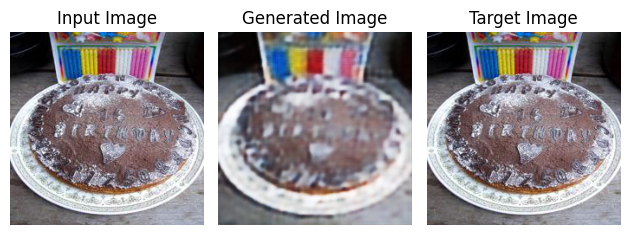

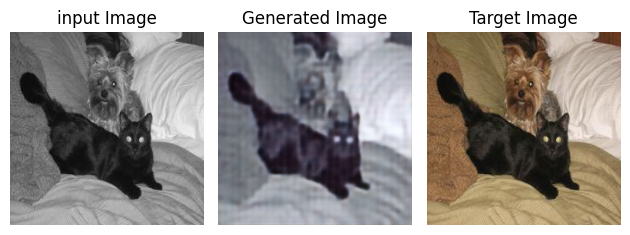

Epoch [10/100], Loss: 0.1980
Validation Loss: 0.2196


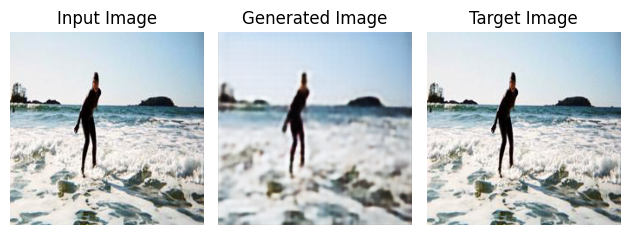

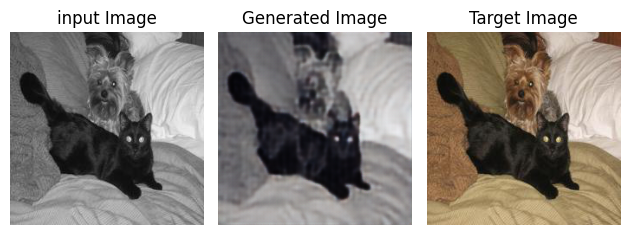

Epoch [11/100], Loss: 0.1579
Validation Loss: 0.1938


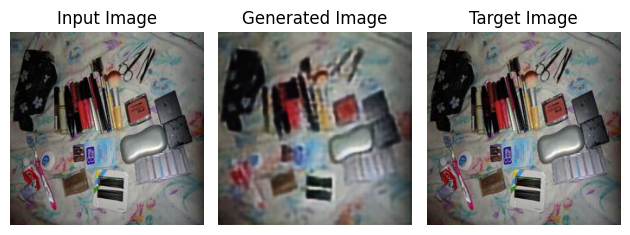

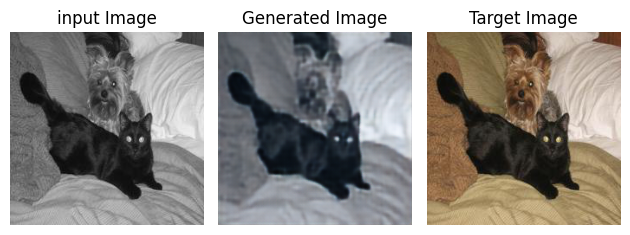

Epoch [12/100], Loss: 0.1833
Validation Loss: 0.2023


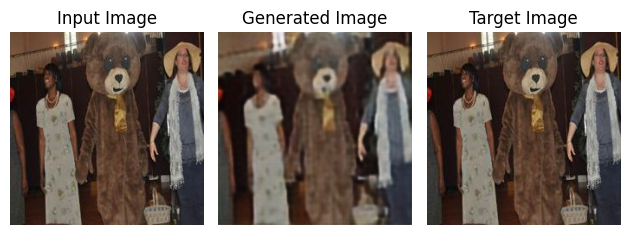

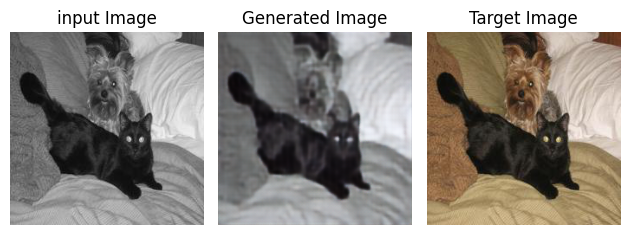

Epoch [13/100], Loss: 0.1637
Validation Loss: 0.1907


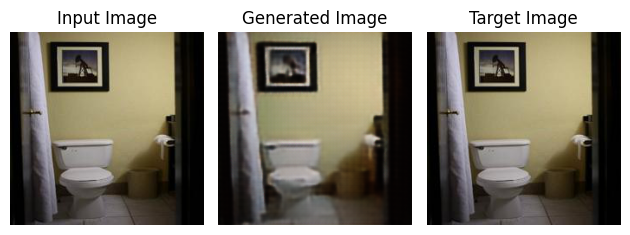

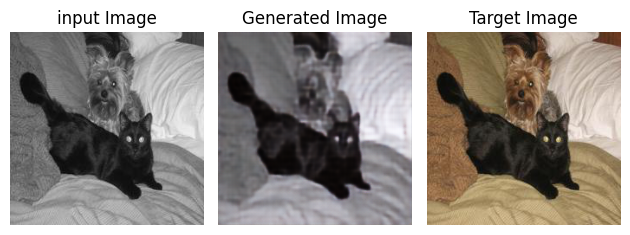

Epoch [14/100], Loss: 0.1642
Validation Loss: 0.1933


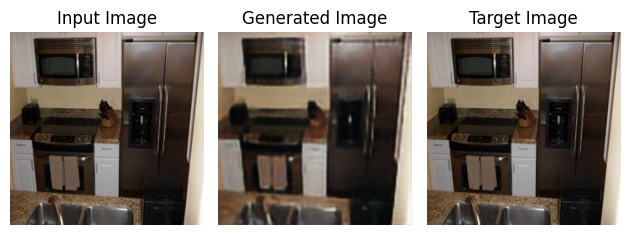

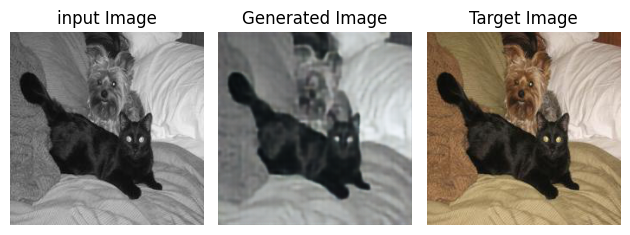

Epoch [15/100], Loss: 0.1598
Validation Loss: 0.1882


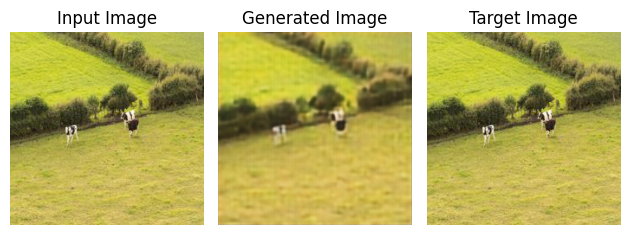

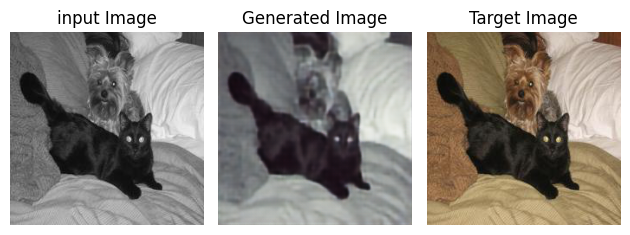

Epoch [16/100], Loss: 0.1640
Validation Loss: 0.1895


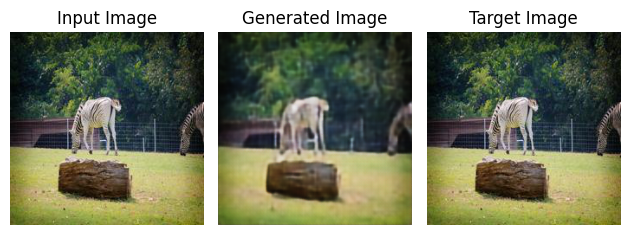

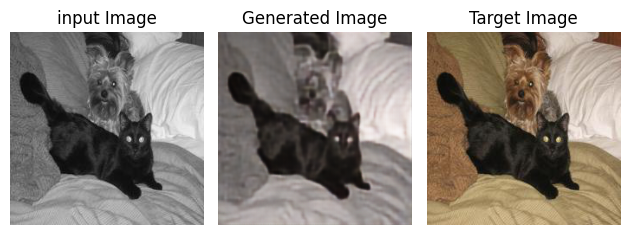

Epoch [17/100], Loss: 0.1365
Validation Loss: 0.1798


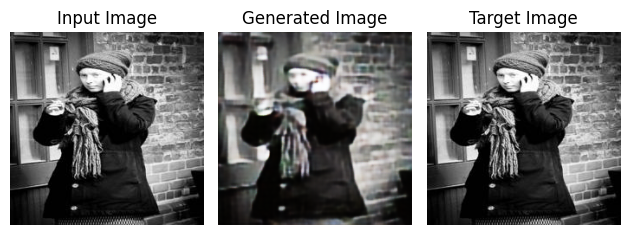

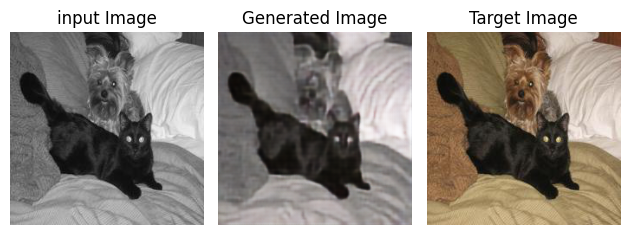

Epoch [18/100], Loss: 0.1442
Validation Loss: 0.1819


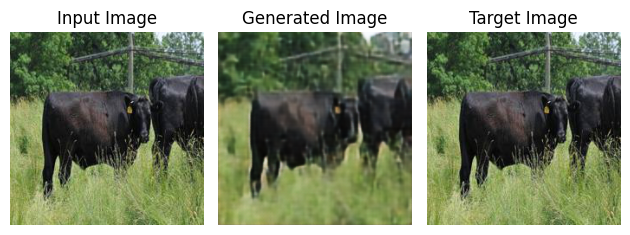

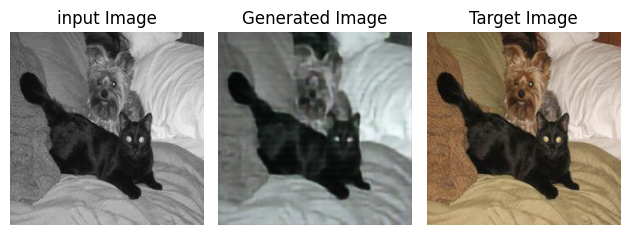

Epoch [19/100], Loss: 0.1639
Validation Loss: 0.1920


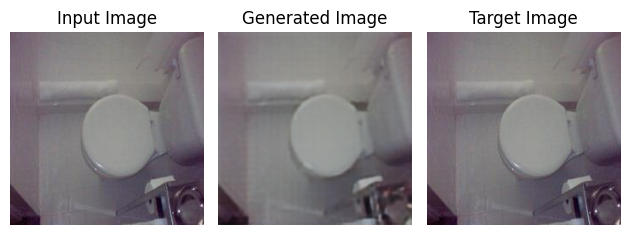

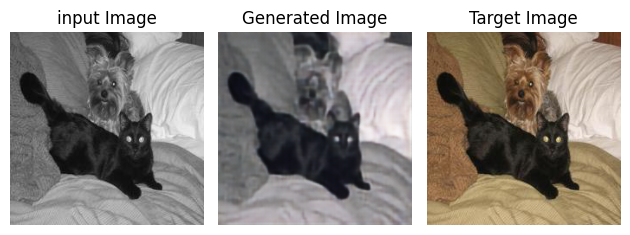

Epoch [20/100], Loss: 0.1569
Validation Loss: 0.1870


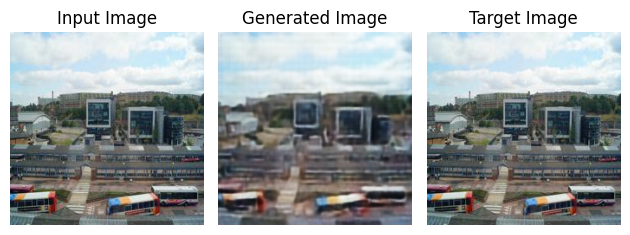

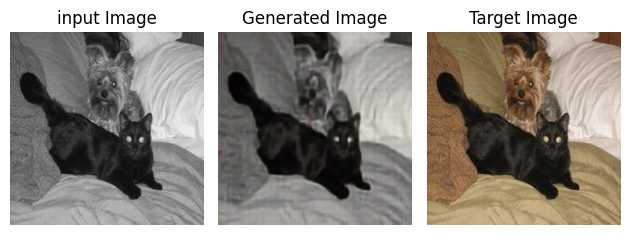

Epoch [21/100], Loss: 0.1499
Validation Loss: 0.1923


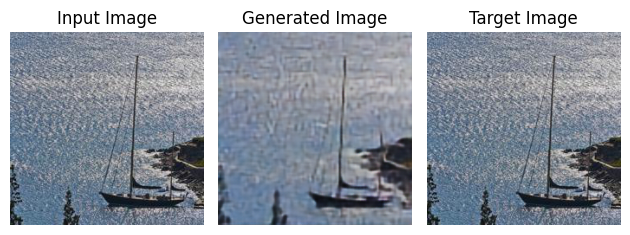

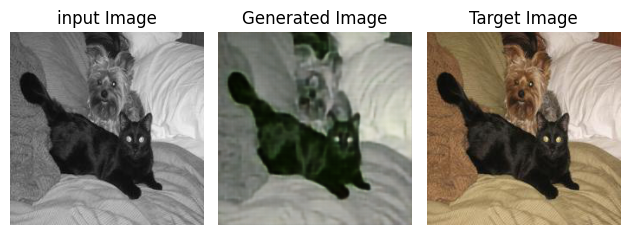

Epoch [22/100], Loss: 0.1482
Validation Loss: 0.1886


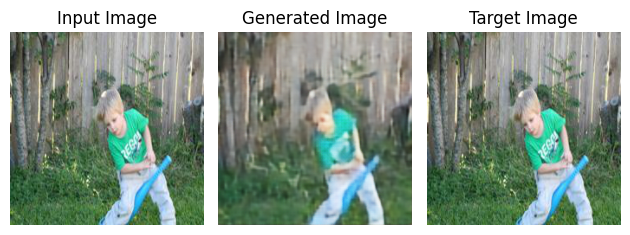

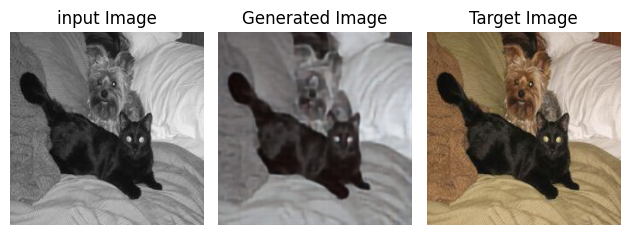

Epoch [23/100], Loss: 0.1530
Validation Loss: 0.1819


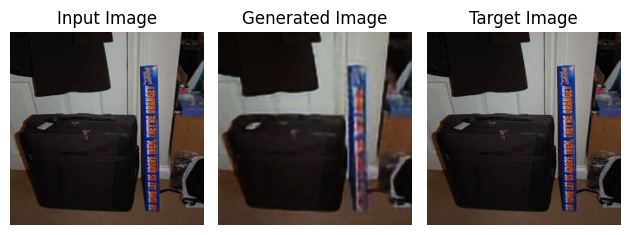

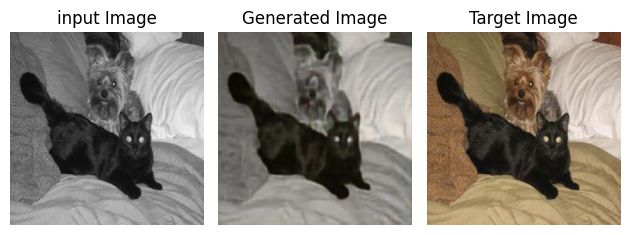

Epoch [24/100], Loss: 0.1385
Validation Loss: 0.1804


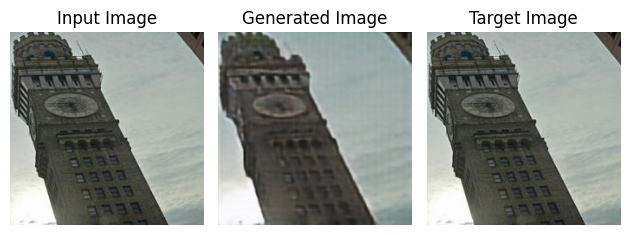

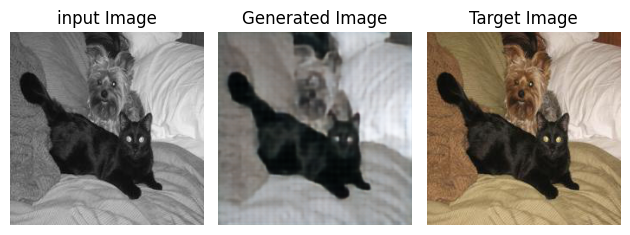

Epoch [25/100], Loss: 0.1645
Validation Loss: 0.1921


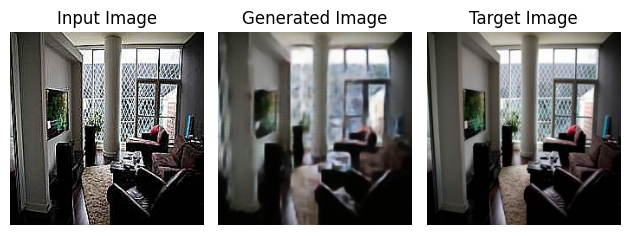

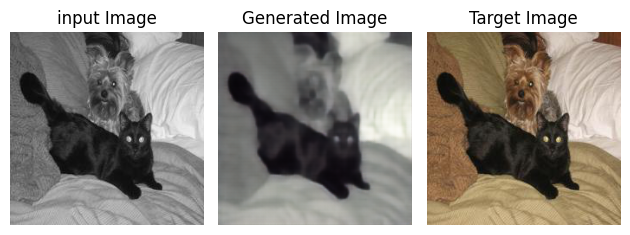

Epoch [26/100], Loss: 0.1584
Validation Loss: 0.1973


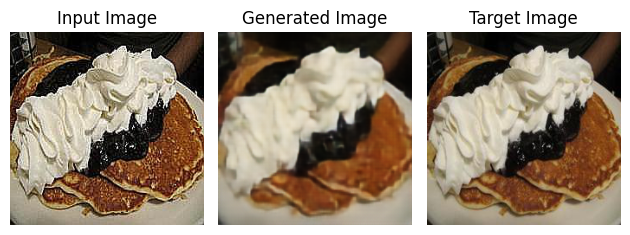

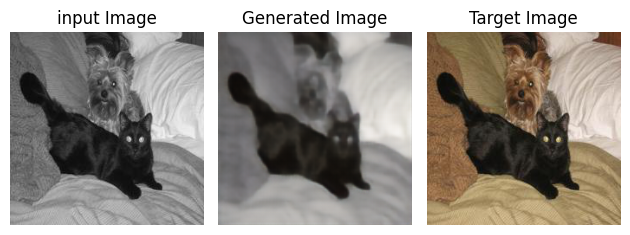

Epoch [27/100], Loss: 0.1573
Validation Loss: 0.1950


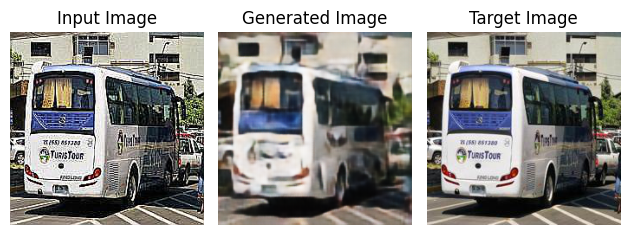

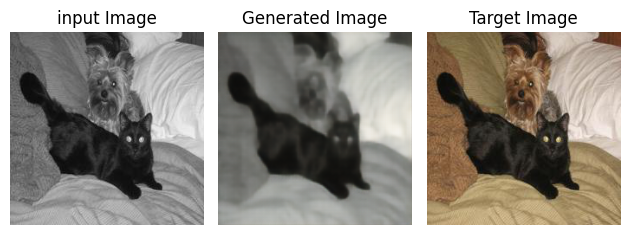

Epoch [28/100], Loss: 0.1538
Validation Loss: 0.1947


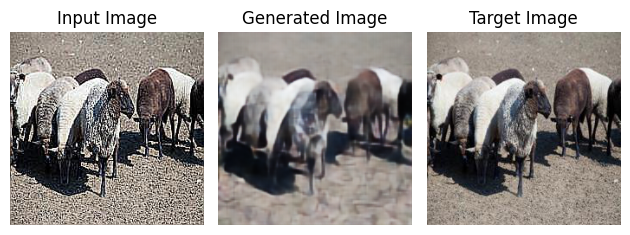

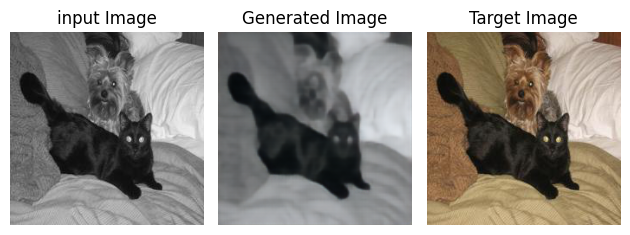

Epoch [29/100], Loss: 0.1679
Validation Loss: 0.1982


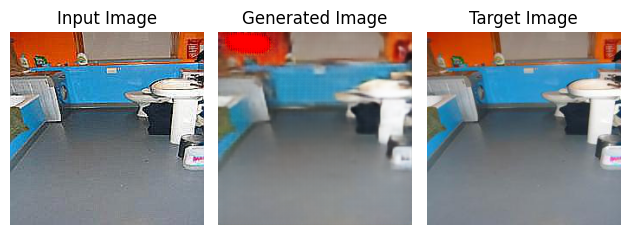

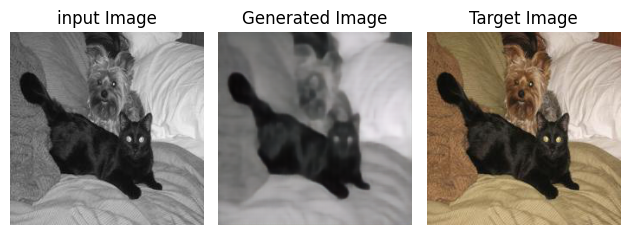

Epoch [30/100], Loss: 0.1595
Validation Loss: 0.1957


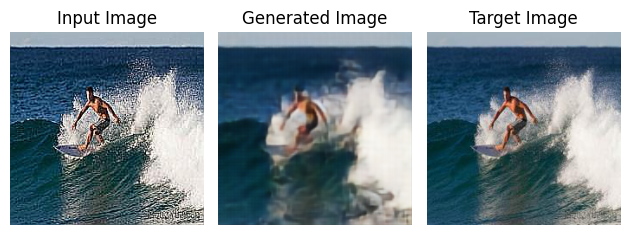

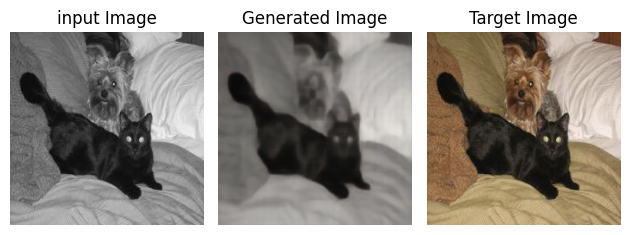

Epoch [31/100], Loss: 0.1463
Validation Loss: 0.1919


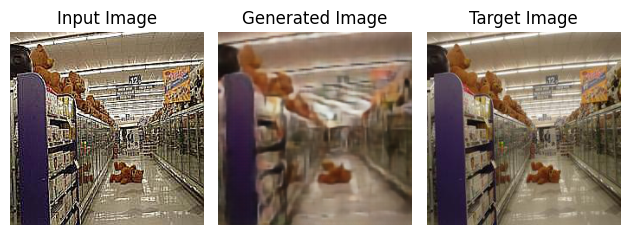

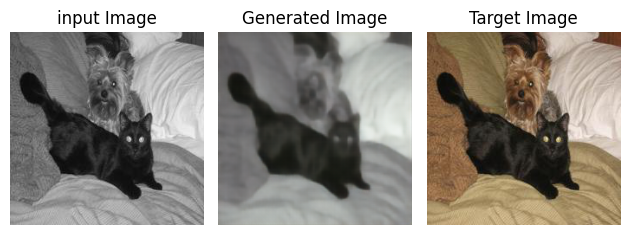

Epoch [32/100], Loss: 0.1613
Validation Loss: 0.1987


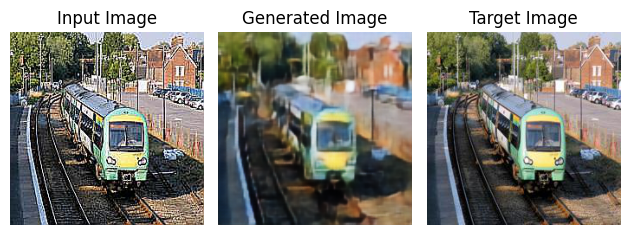

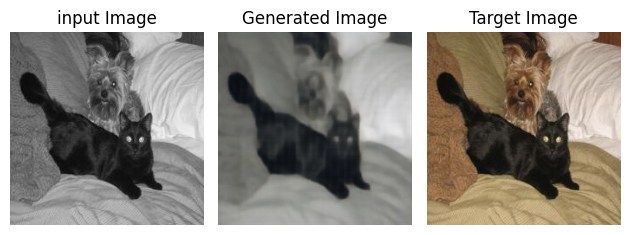

Epoch [33/100], Loss: 0.1523
Validation Loss: 0.1949


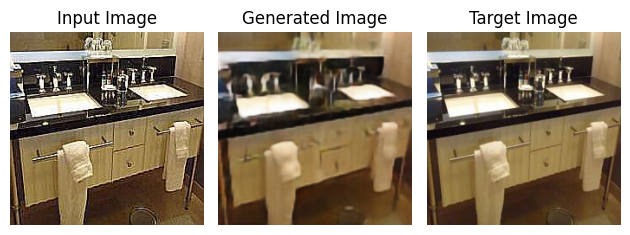

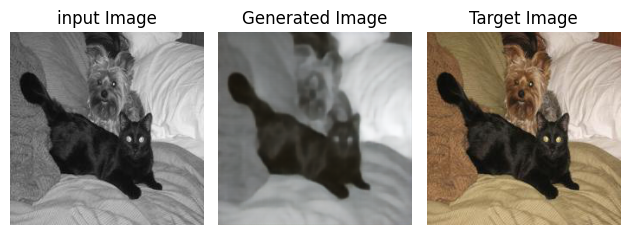

Epoch [34/100], Loss: 0.1640
Validation Loss: 0.1970


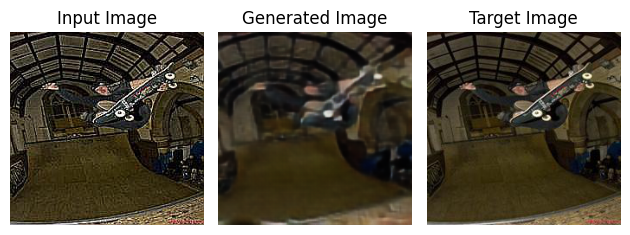

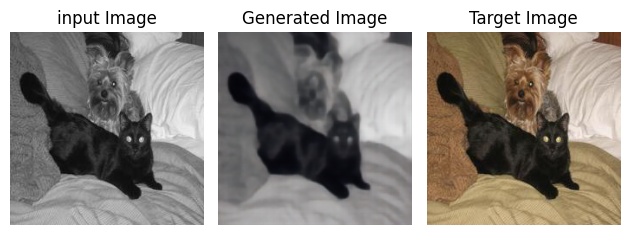

Epoch [35/100], Loss: 0.1589
Validation Loss: 0.1968


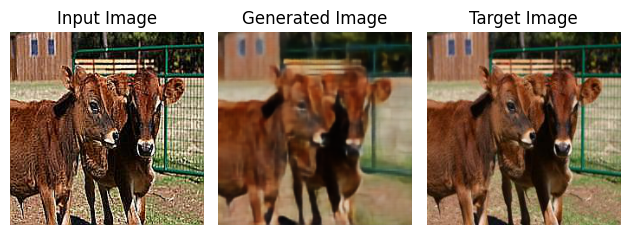

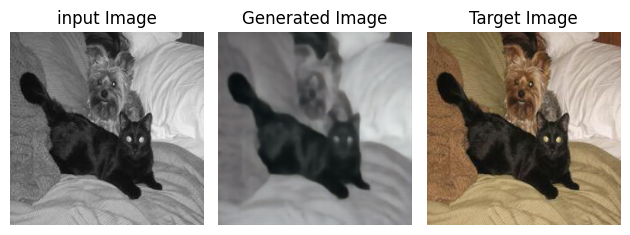

Epoch [36/100], Loss: 0.1614
Validation Loss: 0.1953


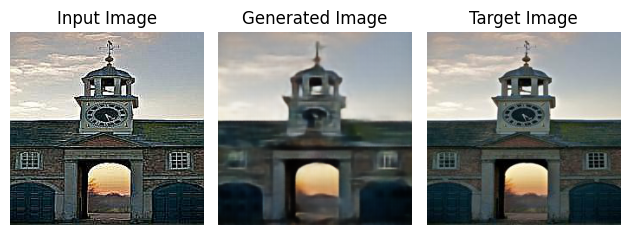

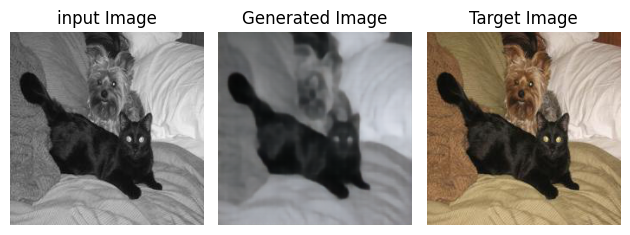

Epoch [37/100], Loss: 0.1689
Validation Loss: 0.1978


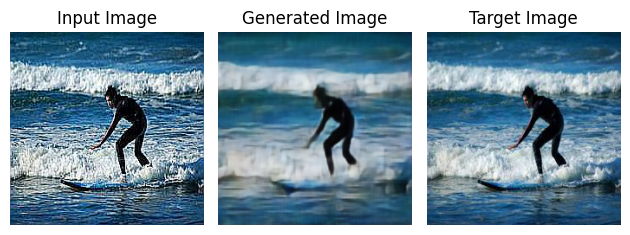

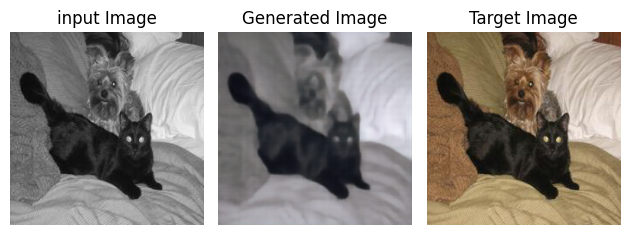

Epoch [38/100], Loss: 0.1636
Validation Loss: 0.1963


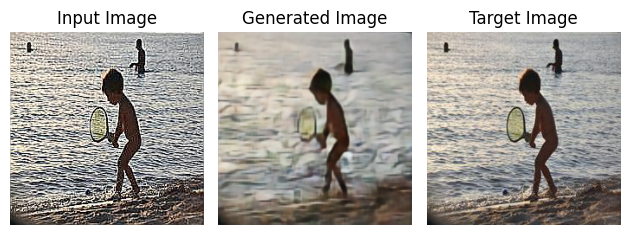

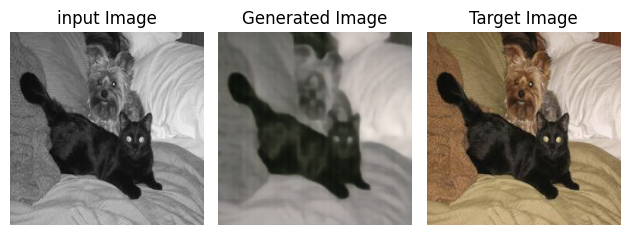

Epoch [39/100], Loss: 0.1417
Validation Loss: 0.1894


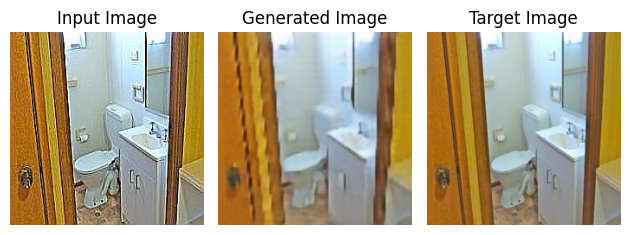

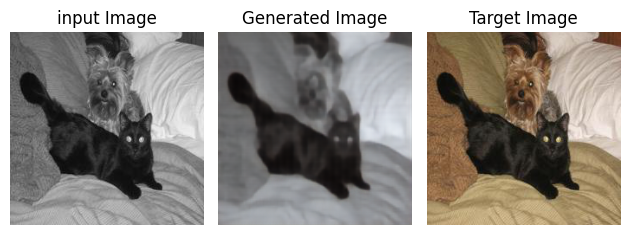

Epoch [40/100], Loss: 0.1654
Validation Loss: 0.1953


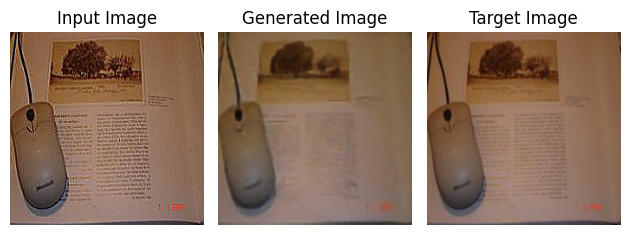

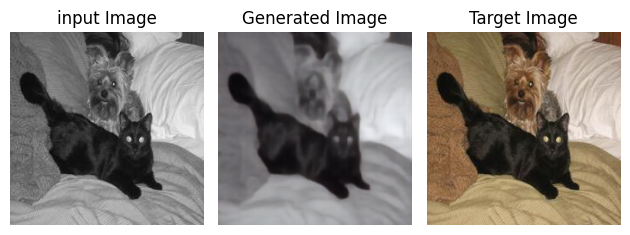

Epoch [41/100], Loss: 0.1629
Validation Loss: 0.1949


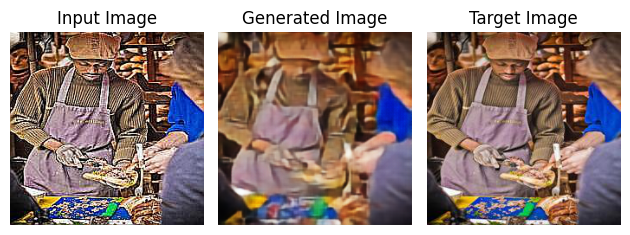

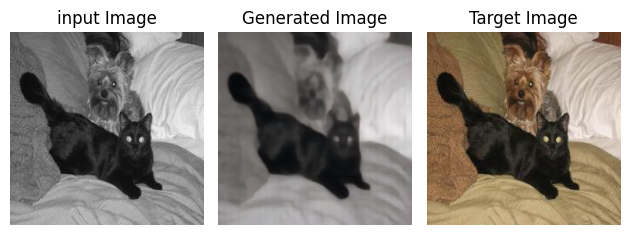

Epoch [42/100], Loss: 0.1488
Validation Loss: 0.1905


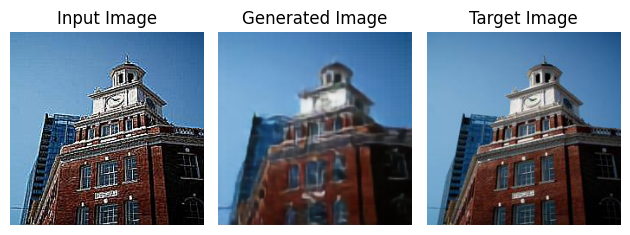

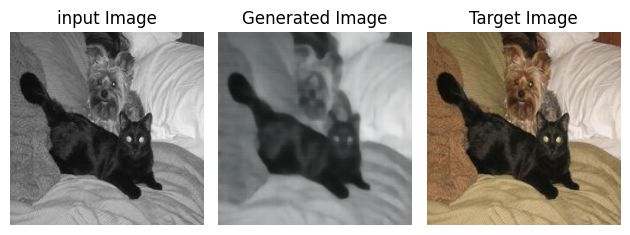

Epoch [43/100], Loss: 0.1661
Validation Loss: 0.1977


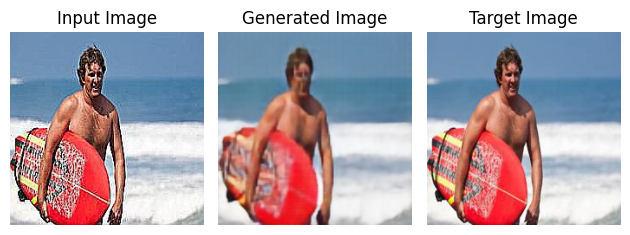

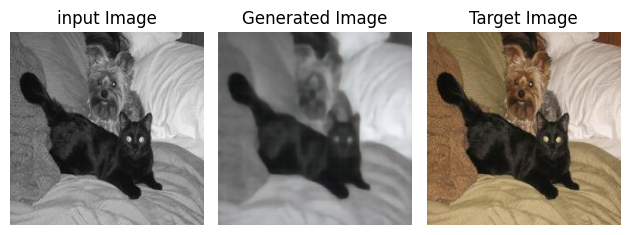

Epoch [44/100], Loss: 0.1621
Validation Loss: 0.1958


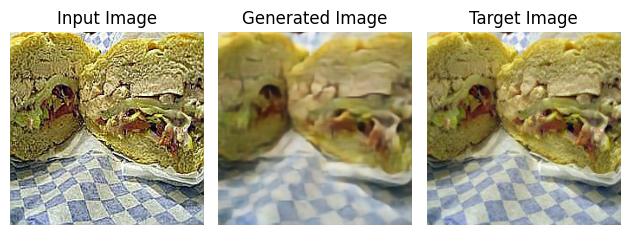

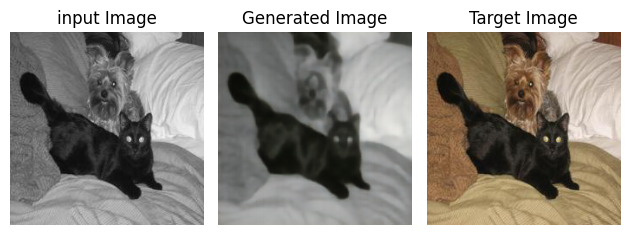

Epoch [45/100], Loss: 0.1570
Validation Loss: 0.1926


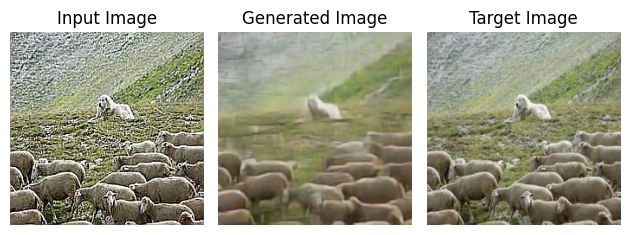

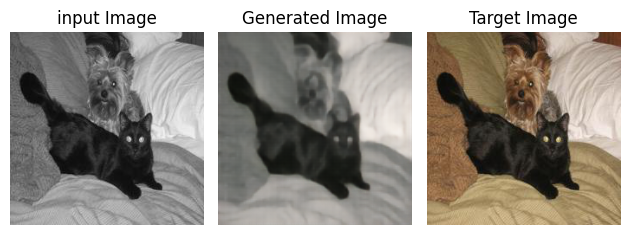

Epoch [46/100], Loss: 0.1473
Validation Loss: 0.1894


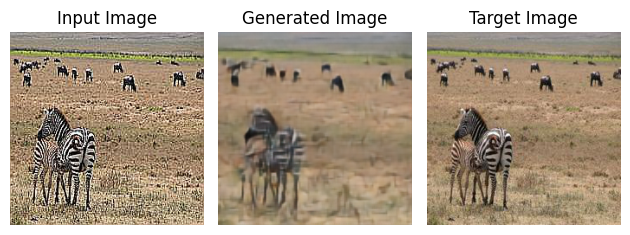

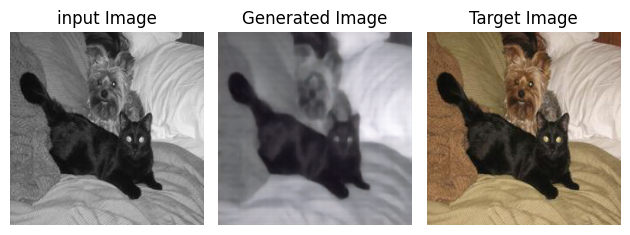

Epoch [47/100], Loss: 0.1743
Validation Loss: 0.2035


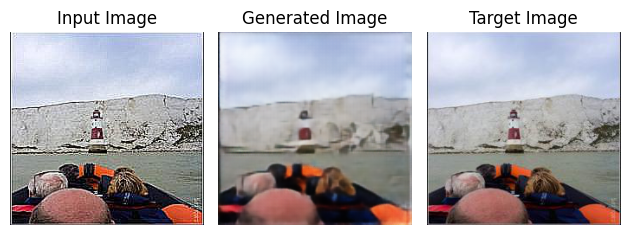

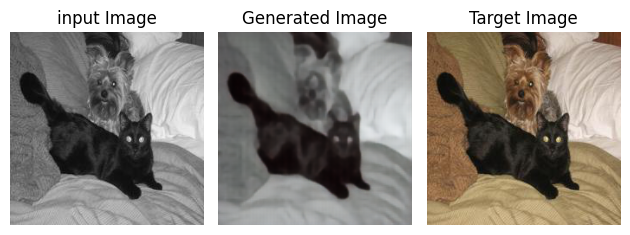

Epoch [48/100], Loss: 0.1575
Validation Loss: 0.1901


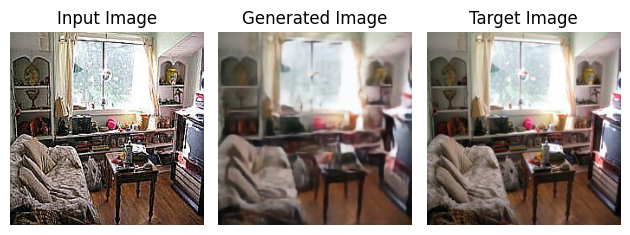

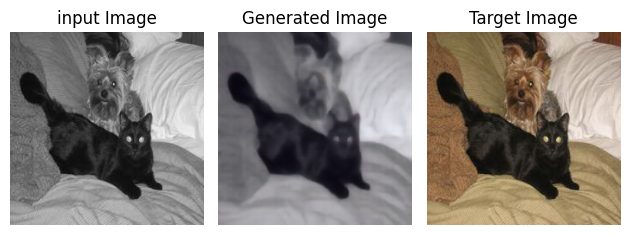

Epoch [49/100], Loss: 0.1672
Validation Loss: 0.1994


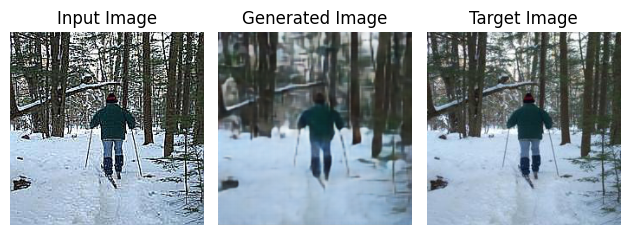

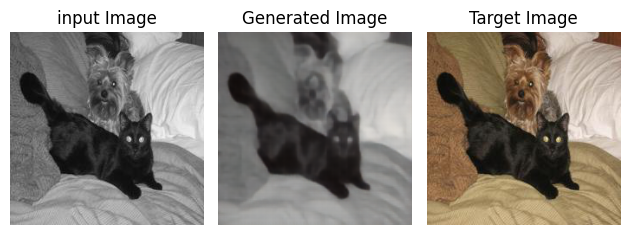

Epoch [50/100], Loss: 0.1594
Validation Loss: 0.1987


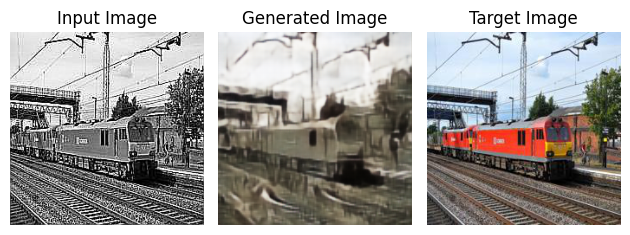

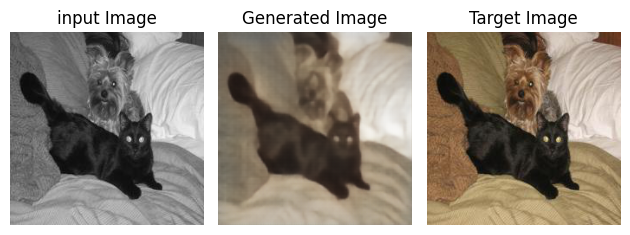

Epoch [51/100], Loss: 0.1144
Validation Loss: 0.1937


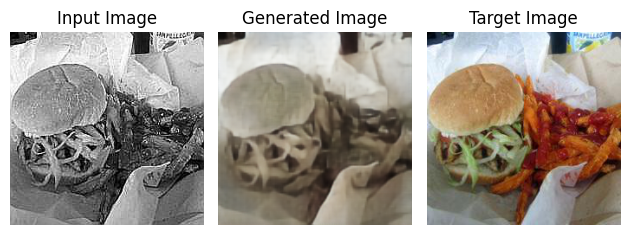

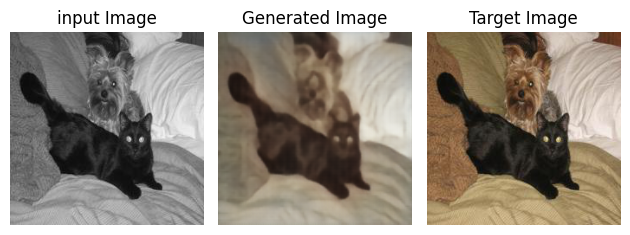

Epoch [52/100], Loss: 0.1110
Validation Loss: 0.1881


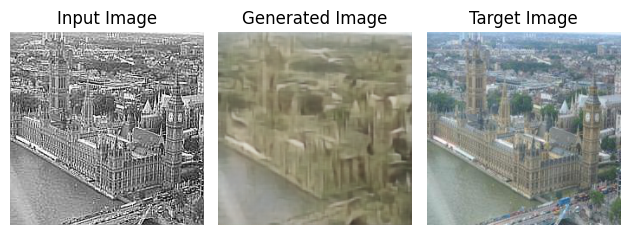

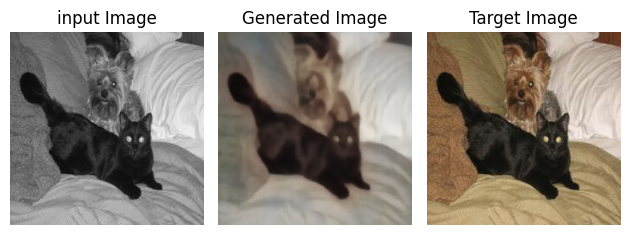

Epoch [53/100], Loss: 0.1233
Validation Loss: 0.1850


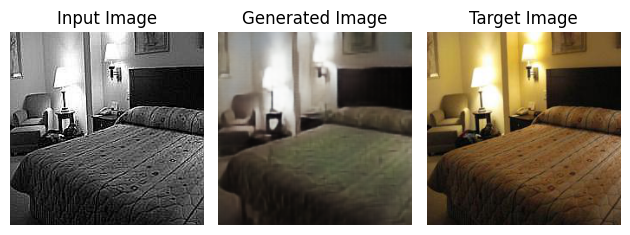

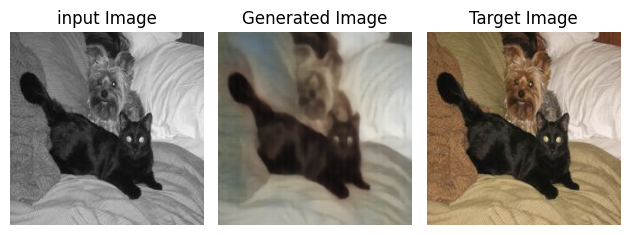

Epoch [54/100], Loss: 0.1238
Validation Loss: 0.1843


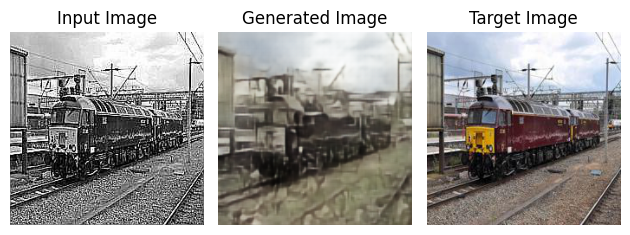

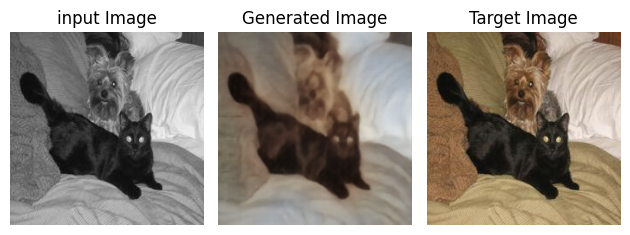

Epoch [55/100], Loss: 0.1212
Validation Loss: 0.1876


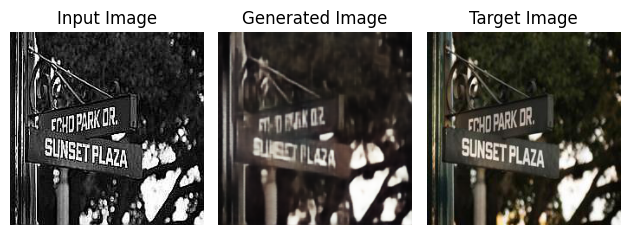

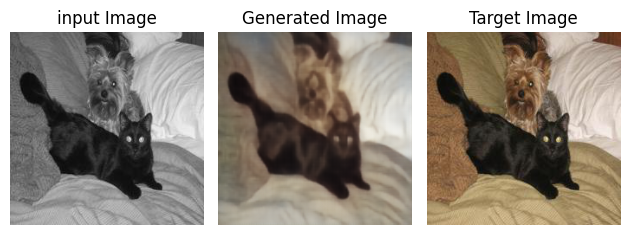

Epoch [56/100], Loss: 0.1088
Validation Loss: 0.1828


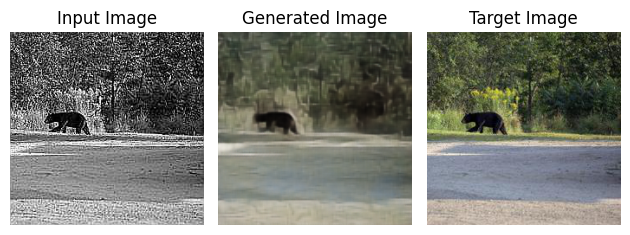

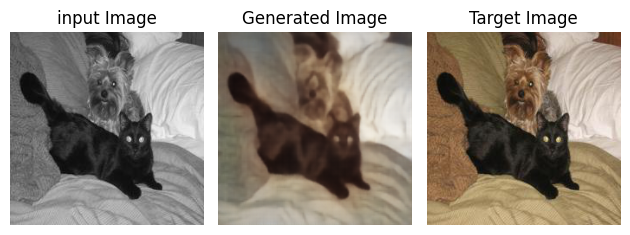

Epoch [57/100], Loss: 0.1076
Validation Loss: 0.1836


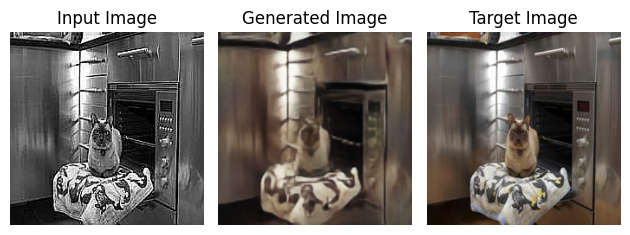

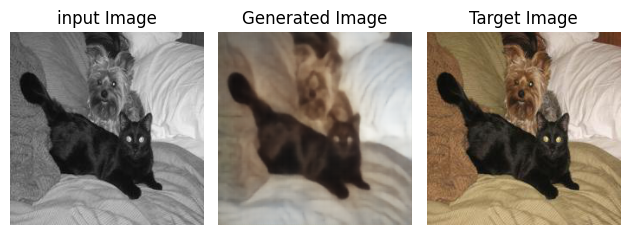

Epoch [58/100], Loss: 0.1219
Validation Loss: 0.1859


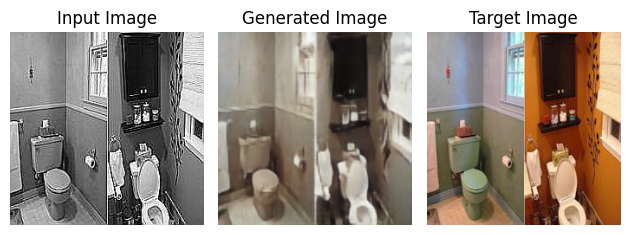

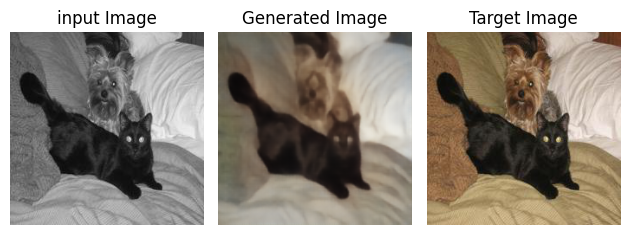

Epoch [59/100], Loss: 0.1107
Validation Loss: 0.1832


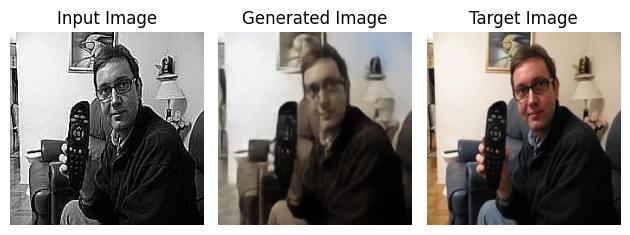

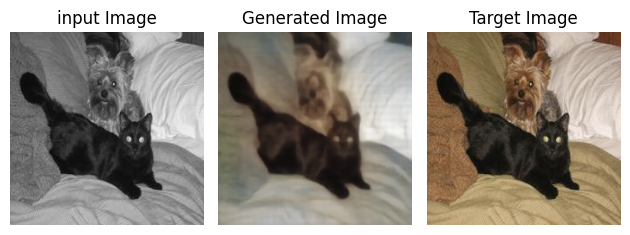

Epoch [60/100], Loss: 0.1236
Validation Loss: 0.1852


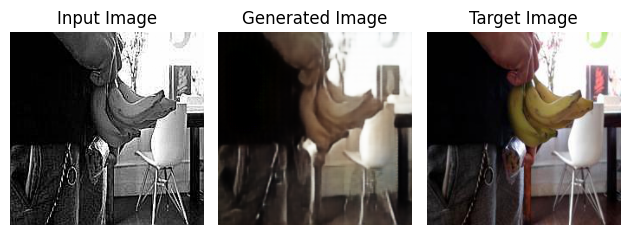

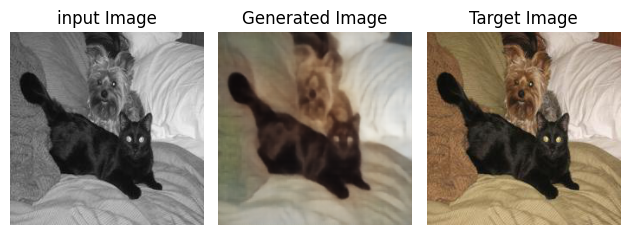

Epoch [61/100], Loss: 0.1049
Validation Loss: 0.1820


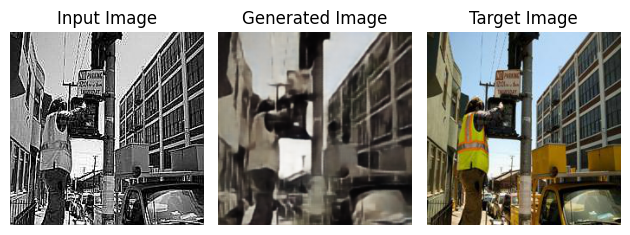

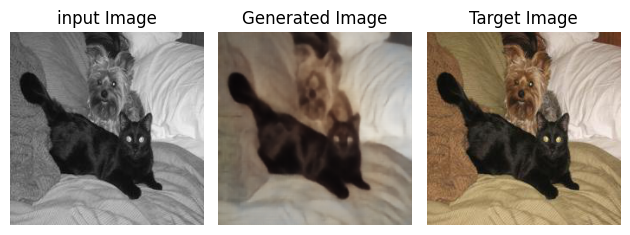

Epoch [62/100], Loss: 0.1066
Validation Loss: 0.1825


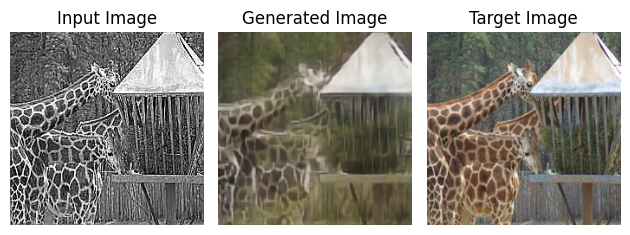

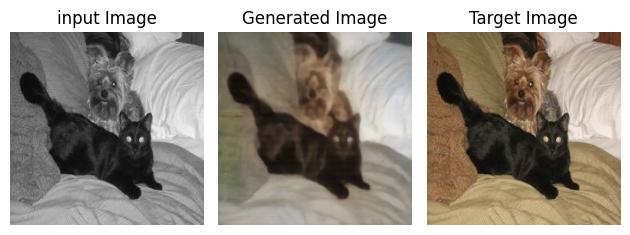

Epoch [63/100], Loss: 0.1153
Validation Loss: 0.1815


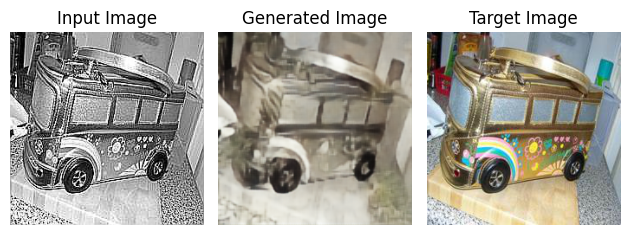

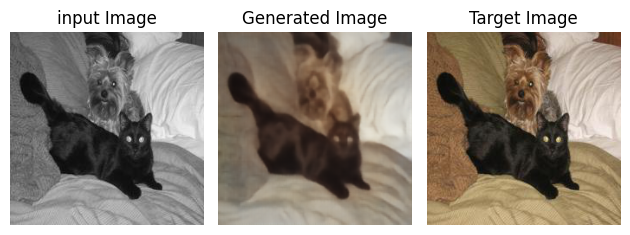

Epoch [64/100], Loss: 0.1060
Validation Loss: 0.1852


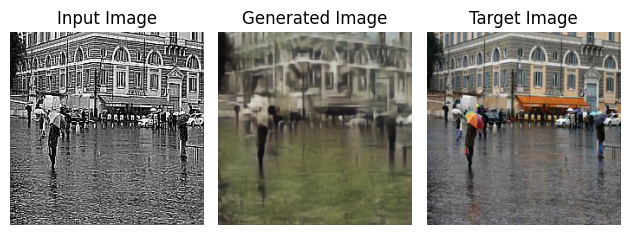

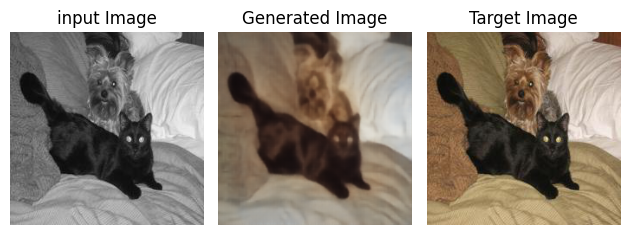

Epoch [65/100], Loss: 0.1025
Validation Loss: 0.1874


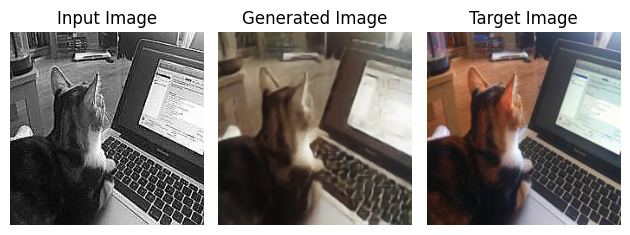

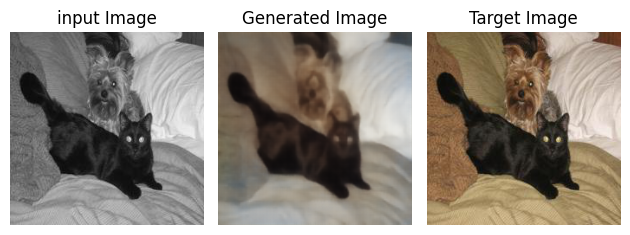

Epoch [66/100], Loss: 0.1222
Validation Loss: 0.1856


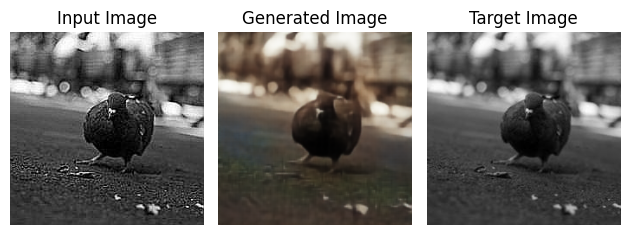

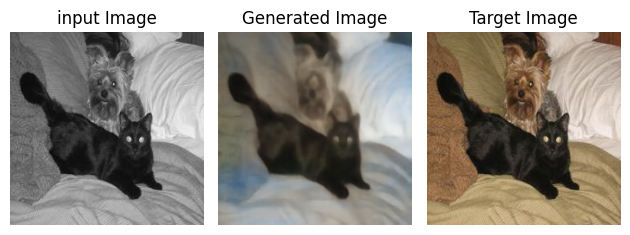

Epoch [67/100], Loss: 0.1537
Validation Loss: 0.1916


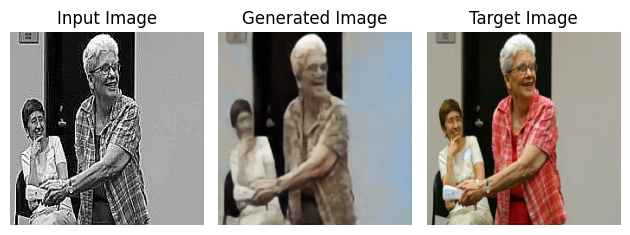

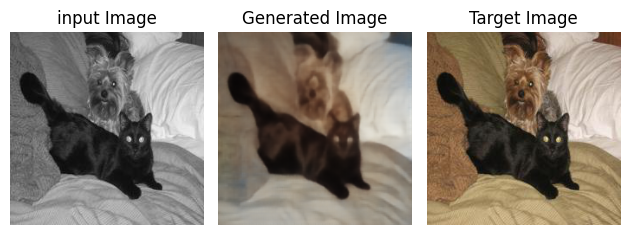

Epoch [68/100], Loss: 0.1109
Validation Loss: 0.1831


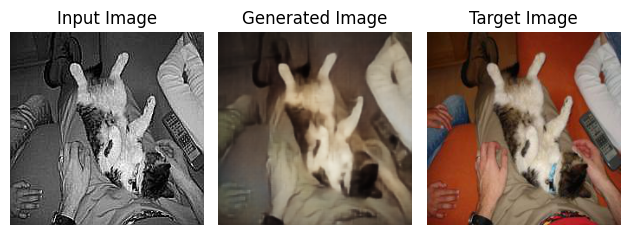

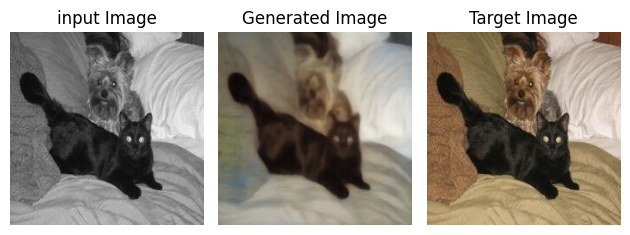

Epoch [69/100], Loss: 0.1193
Validation Loss: 0.1848


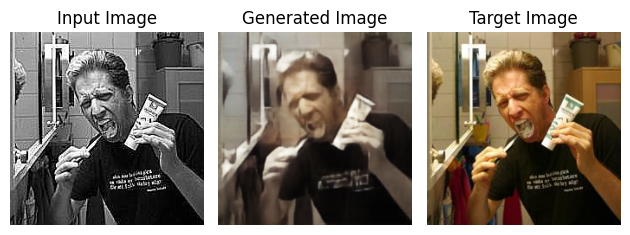

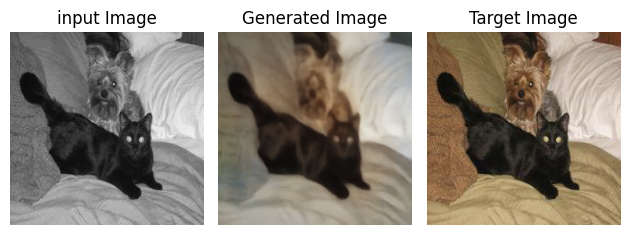

Epoch [70/100], Loss: 0.1106
Validation Loss: 0.1838


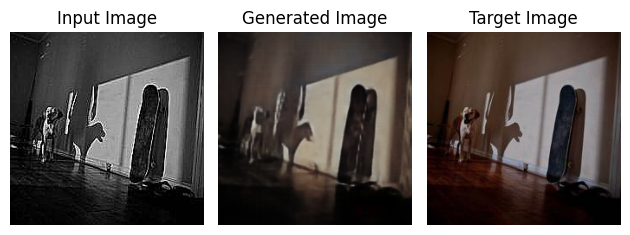

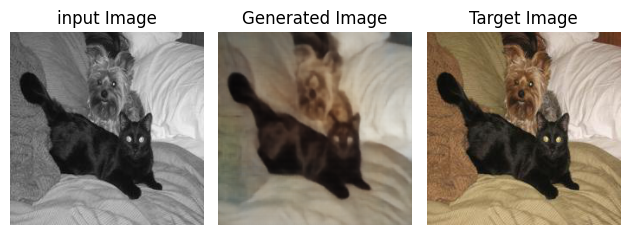

Epoch [71/100], Loss: 0.1075
Validation Loss: 0.1844


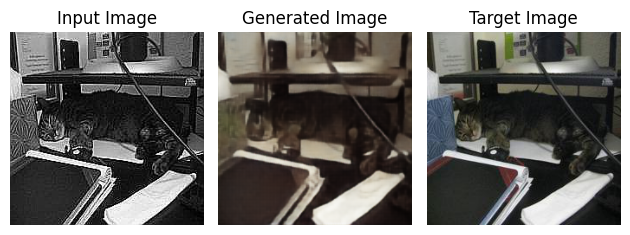

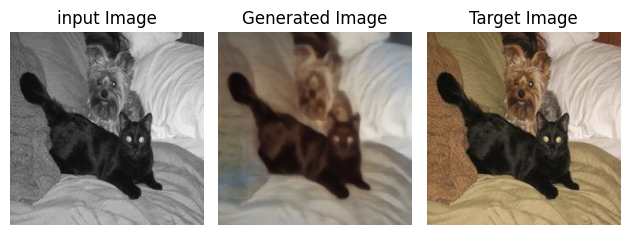

Epoch [72/100], Loss: 0.1174
Validation Loss: 0.1846


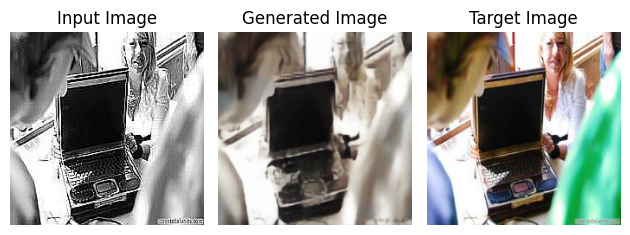

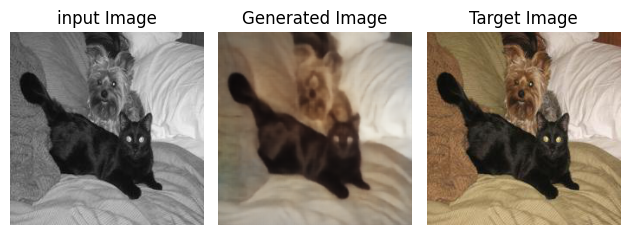

Epoch [73/100], Loss: 0.0952
Validation Loss: 0.1844


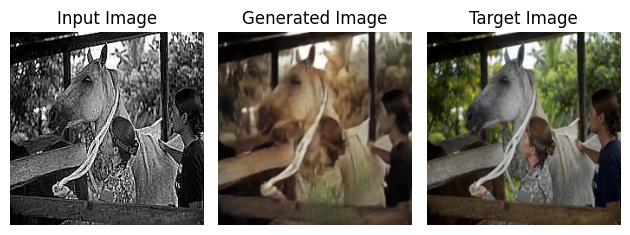

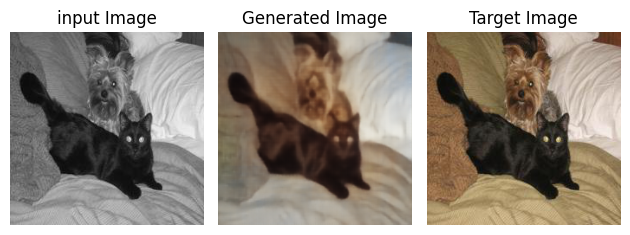

Epoch [74/100], Loss: 0.1093
Validation Loss: 0.1879


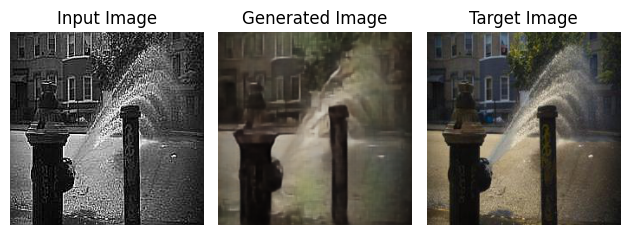

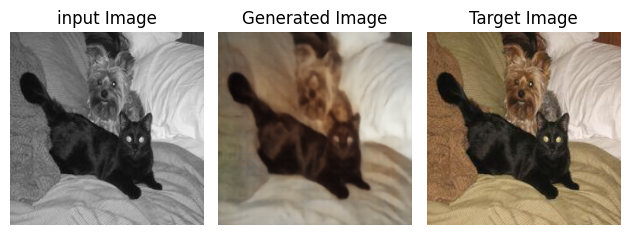

Epoch [75/100], Loss: 0.1008
Validation Loss: 0.1853


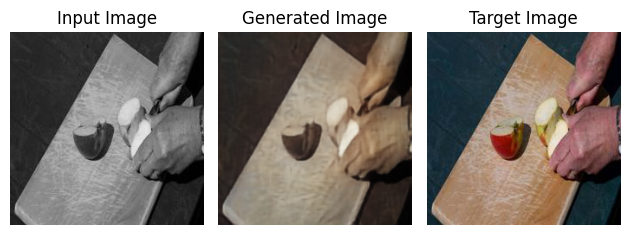

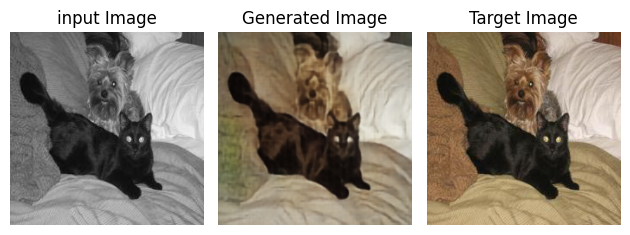

Epoch [76/100], Loss: 0.0829
Validation Loss: 0.1661


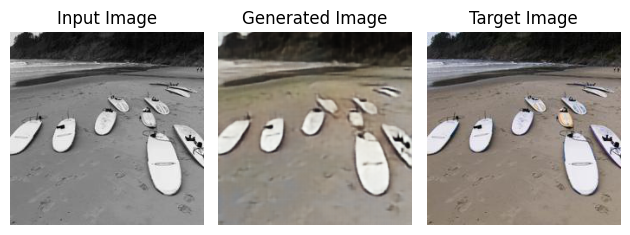

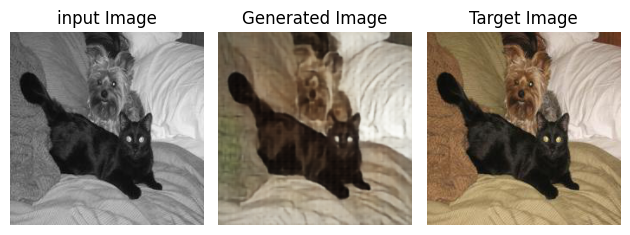

Epoch [77/100], Loss: 0.0968
Validation Loss: 0.1713


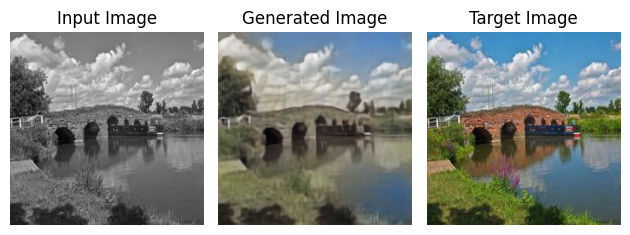

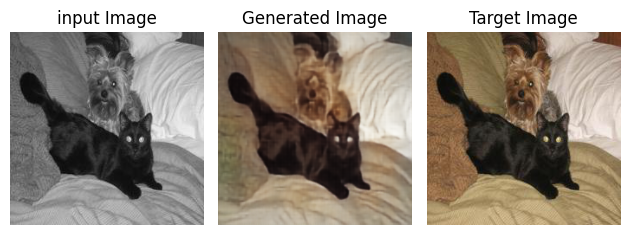

Epoch [78/100], Loss: 0.0795
Validation Loss: 0.1663


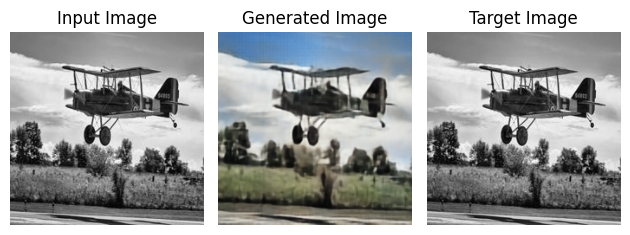

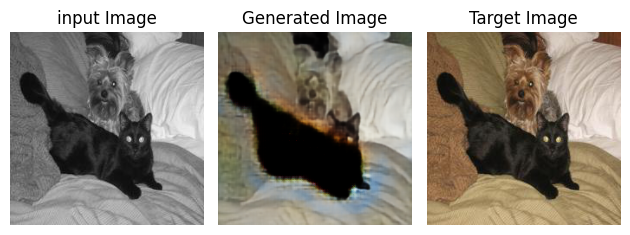

Epoch [79/100], Loss: 0.1816
Validation Loss: 0.2265


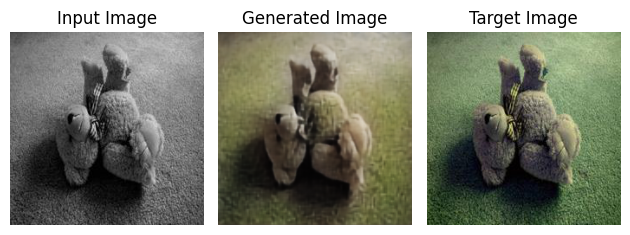

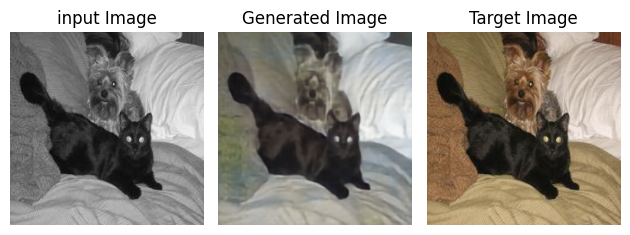

Epoch [80/100], Loss: 0.1410
Validation Loss: 0.1775


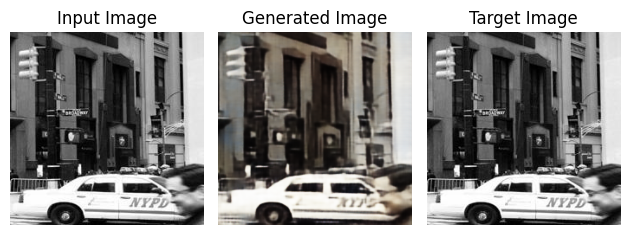

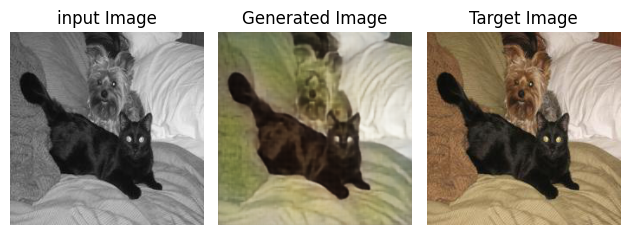

Epoch [81/100], Loss: 0.0876
Validation Loss: 0.1701


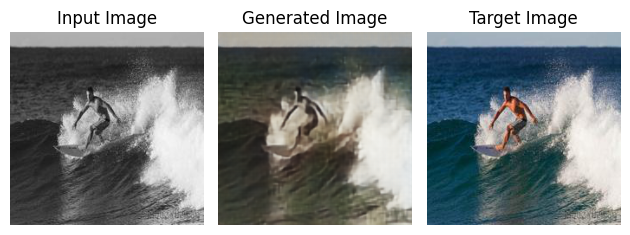

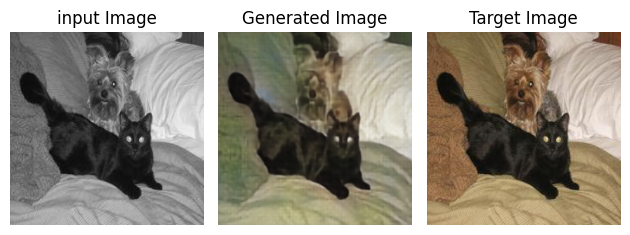

Epoch [82/100], Loss: 0.0986
Validation Loss: 0.1652


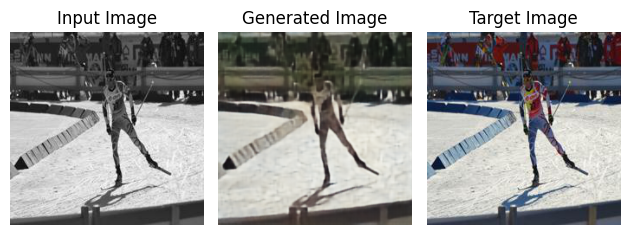

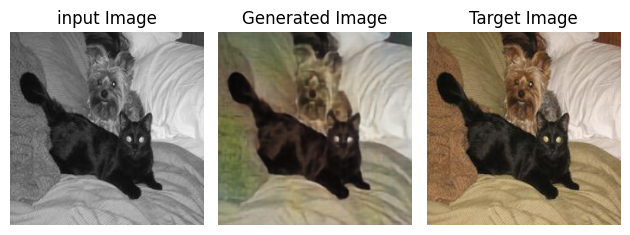

Epoch [83/100], Loss: 0.0915
Validation Loss: 0.1639


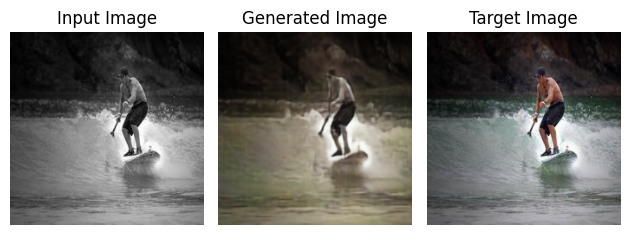

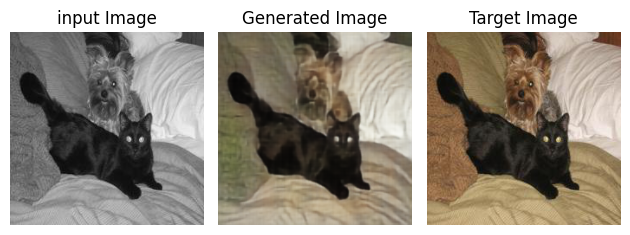

Epoch [84/100], Loss: 0.0883
Validation Loss: 0.1633


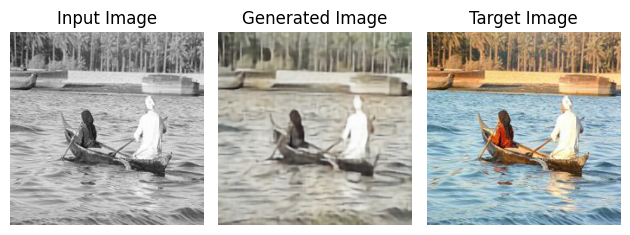

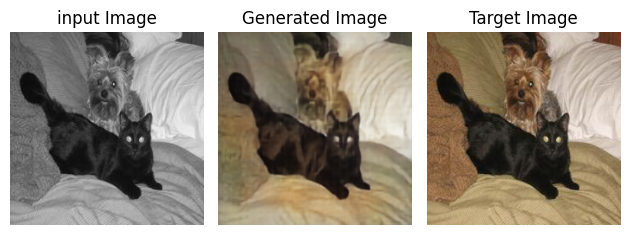

Epoch [85/100], Loss: 0.0780
Validation Loss: 0.1685


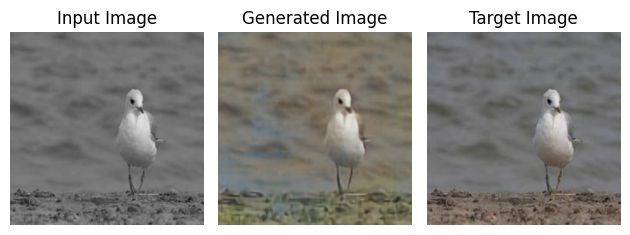

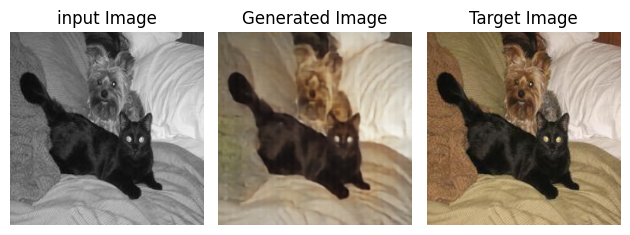

Epoch [86/100], Loss: 0.0876
Validation Loss: 0.1727


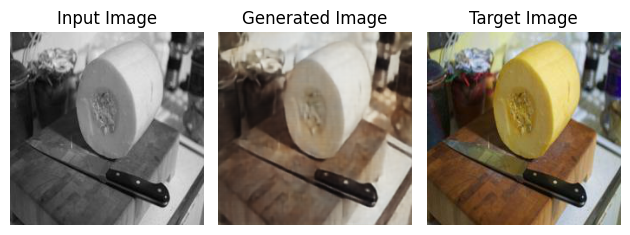

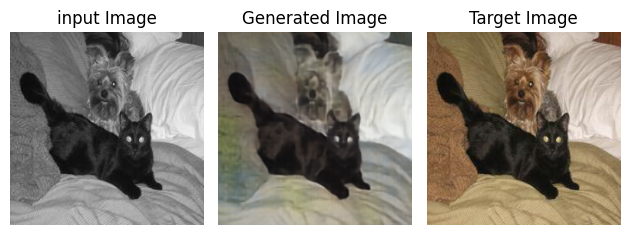

Epoch [87/100], Loss: 0.1224
Validation Loss: 0.1666


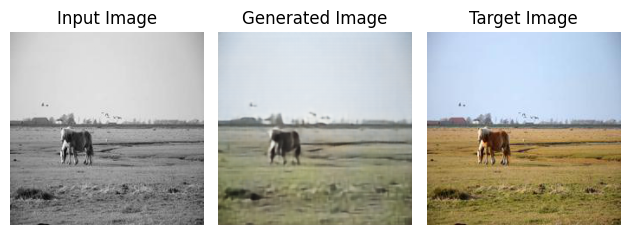

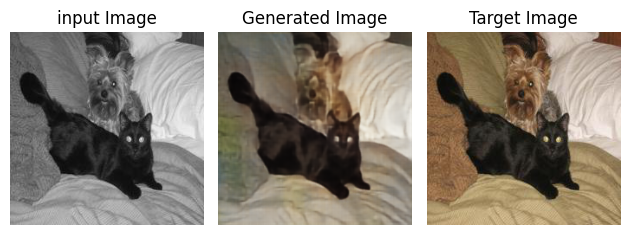

Epoch [88/100], Loss: 0.0993
Validation Loss: 0.1676


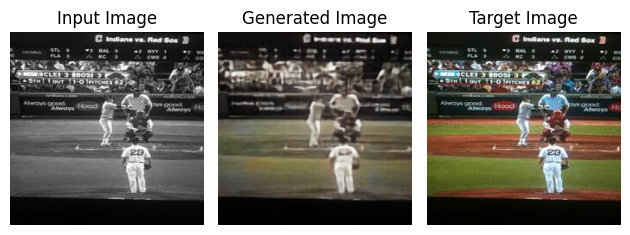

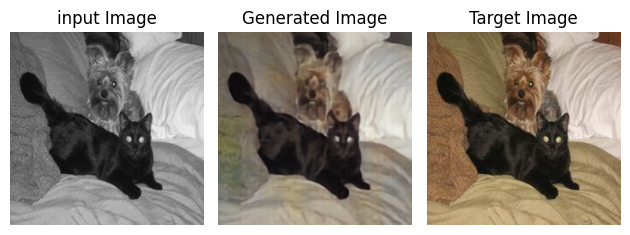

Epoch [89/100], Loss: 0.1021
Validation Loss: 0.1627


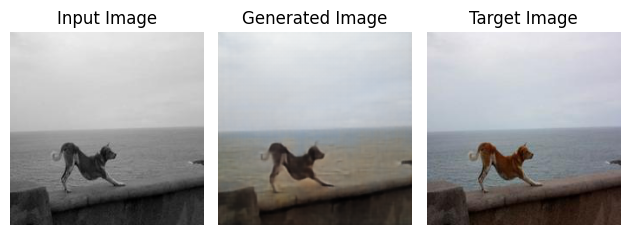

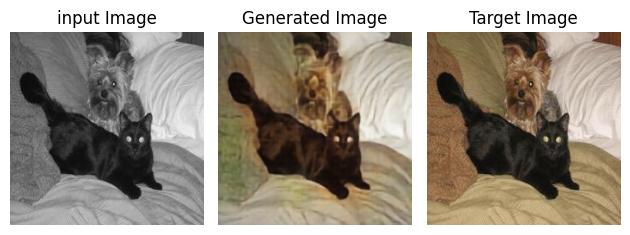

Epoch [90/100], Loss: 0.0816
Validation Loss: 0.1758


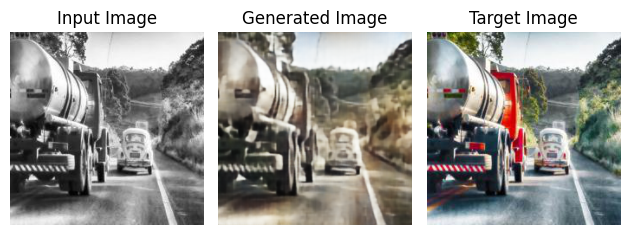

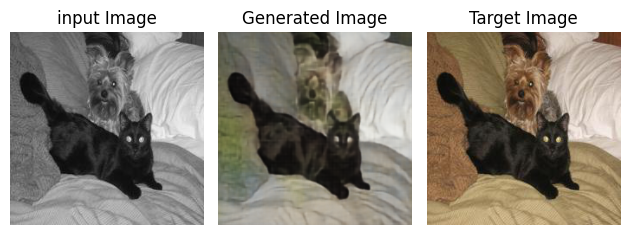

Epoch [91/100], Loss: 0.1191
Validation Loss: 0.1646


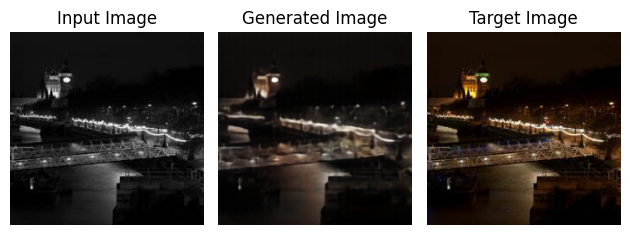

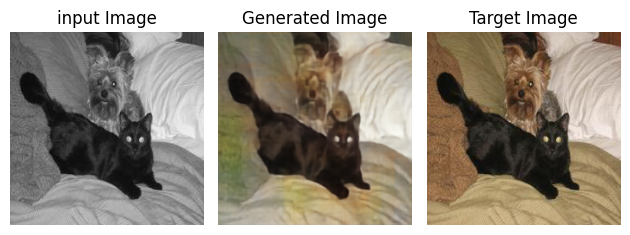

Epoch [92/100], Loss: 0.0873
Validation Loss: 0.1692


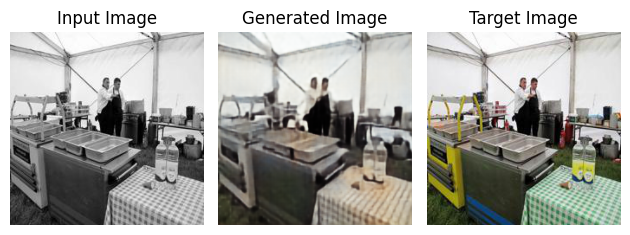

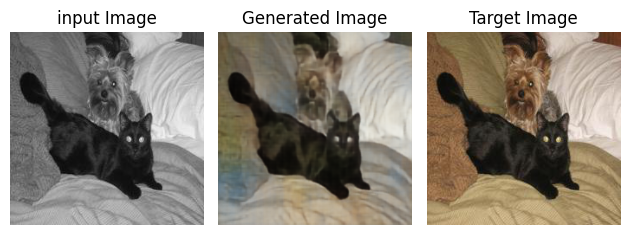

Epoch [93/100], Loss: 0.1096
Validation Loss: 0.1667


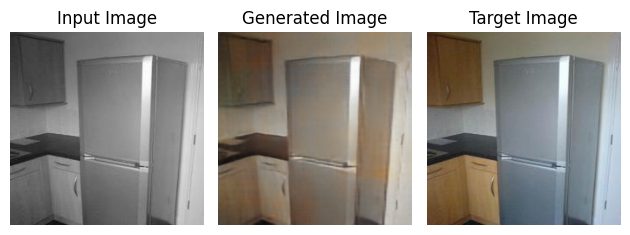

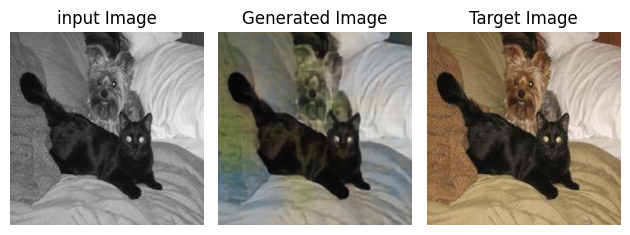

Epoch [94/100], Loss: 0.1413
Validation Loss: 0.1776


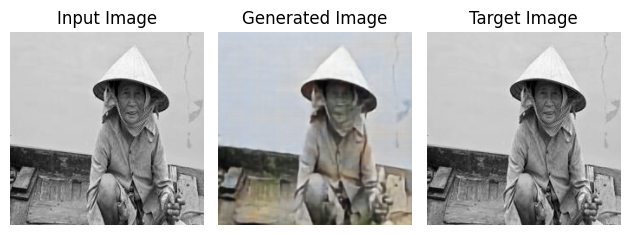

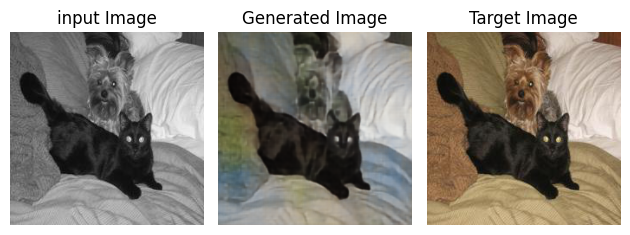

Epoch [95/100], Loss: 0.1424
Validation Loss: 0.1722


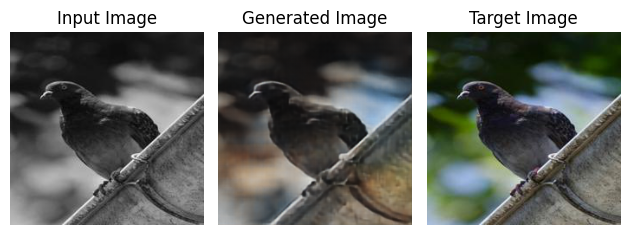

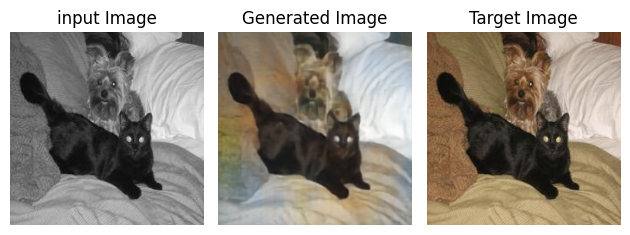

Epoch [96/100], Loss: 0.1314
Validation Loss: 0.1851


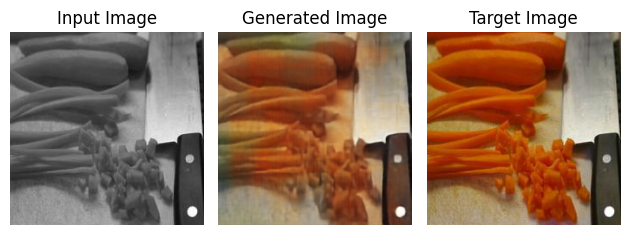

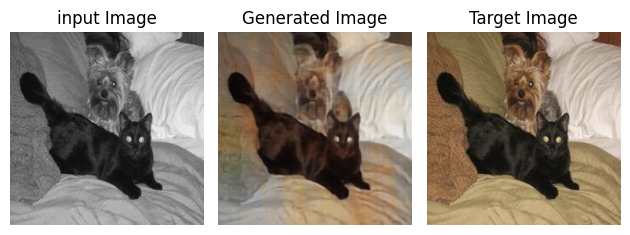

Epoch [97/100], Loss: 0.0897
Validation Loss: 0.1764


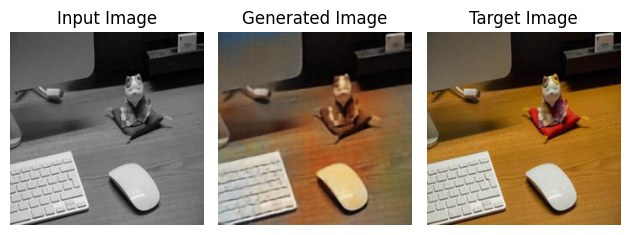

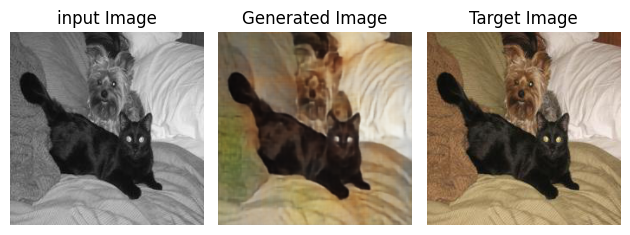

Epoch [98/100], Loss: 0.0833
Validation Loss: 0.1749


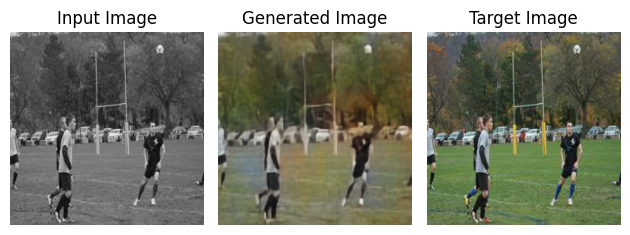

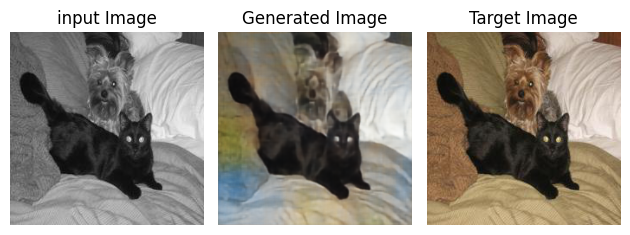

Epoch [99/100], Loss: 0.1379
Validation Loss: 0.1743


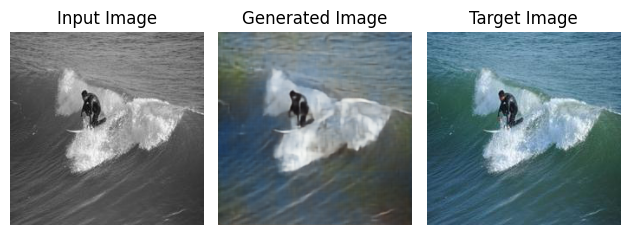

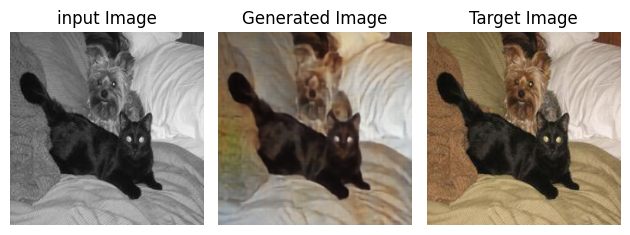

Epoch [100/100], Loss: 0.0999
Validation Loss: 0.1685


In [10]:
train_losses = []
val_losses = []
# Set the device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define the paths for training input and output directories
train_input_dirs = [
    '/content/dataset/train_color_resized',
    '/content/dataset/train_color_edge_enhanced',
    '/content/dataset/train_black_edge_enhanced',
    '/content/dataset/train_black_rgb',
]
train_output_dir = '/content/dataset/train_color_resized'

# Hyperparameters
batch_size = 96
learning_rate = 0.001
num_epochs = 100

# Create the Autoencoder model
model = Autoencoder().to(device)

# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Training loop
for epoch in range(num_epochs):
  plt_inp = None
  plt_gen = None
  plt_out = None
  input_dir = train_input_dirs[epoch//25]
  # input_dir = '/content/dataset/train_black_rgb'
  # print(input_dir)
  # Create datasets and data loaders for input and output
  # input_path = os.path.join(input_dir)
  # print(input_path)
  # output_path = os.path.join(train_output_dir)
  dataset = CustomDataset(input_dir, train_output_dir, transform=ToTensor())
  dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

  # Set model to training mode
  model.train()

  # Iterate over the data batches
  for data in dataloader:
      images, _ = data
      images = images.to(device)
      _ = _.to(device)

      # Forward pass
      outputs = model(images)

      plt_inp = images[0].cpu().squeeze(0)
      plt_gen = outputs[0].cpu().squeeze(0)
      plt_out = _[0].cpu().squeeze(0)

      # Compute loss
      loss = criterion(outputs, _)

      # Backward pass and optimization
      optimizer.zero_grad()
      loss.backward()
      optimizer.step()


    # Print epoch loss
  plt_inp = plt_inp.permute(1, 2, 0).detach().numpy()
  plt_gen = plt_gen.permute(1, 2, 0).detach().numpy()
  plt_out = plt_out.permute(1, 2, 0).detach().numpy()

  fig, ax = plt.subplots(1, 3)
  ax[0].imshow(plt_inp)
  ax[0].axis('off')
  ax[0].set_title('Input Image')
  ax[1].imshow(plt_gen)
  ax[1].axis('off')
  ax[1].set_title('Generated Image')
  ax[2].imshow(plt_out)
  ax[2].axis('off')
  ax[2].set_title('Target Image')
  plt.tight_layout()
  plt.show()


  val_input_dir = '/content/dataset/val_black'
  val_output_dir = '/content/dataset/val_color'
  model.eval()

  val_dataset = CustomDataset(val_input_dir, val_output_dir, transform=ToTensor())
  val_dataloader = DataLoader(val_dataset, batch_size=1, shuffle=False)

  # Validation loop
  total_loss = 0.0

  input_img = None
  generated_image = None
  ground_truth = None

  with torch.no_grad():
      for input_image, target_image in val_dataloader:
          input_image = input_image.to(device)
          target_image = target_image.to(device)

          # Forward pass
          output_image = model(input_image)

          # Compute loss
          loss = criterion(output_image, target_image)
          total_loss += loss.item()

          # if generated_image is None:
          ground_truth = target_image.cpu().squeeze(0)
          generated_image = output_image.cpu().squeeze(0)
          input_img = input_image.cpu().squeeze(0)

      # Compute average loss
      avg_loss = total_loss / len(val_dataloader)

      generated_image = generated_image.permute(1, 2, 0).numpy()
      ground_truth = ground_truth.permute(1, 2, 0).numpy()
      input_img = input_img.permute(1, 2, 0).numpy()

      fig, ax = plt.subplots(1, 3)
      ax[0].imshow(input_img)
      ax[0].axis('off')
      ax[0].set_title('input Image')
      ax[1].imshow(generated_image)
      ax[1].axis('off')
      ax[1].set_title('Generated Image')
      ax[2].imshow(ground_truth)
      ax[2].axis('off')
      ax[2].set_title('Target Image')
      plt.tight_layout()
      plt.show()

      print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
      print(f'Validation Loss: {avg_loss:.4f}')
      train_losses.append(loss.item())
      val_losses.append(avg_loss)


# Save the trained model
# torch.save(model.state_dict(), 'autoencoder_model.pth')

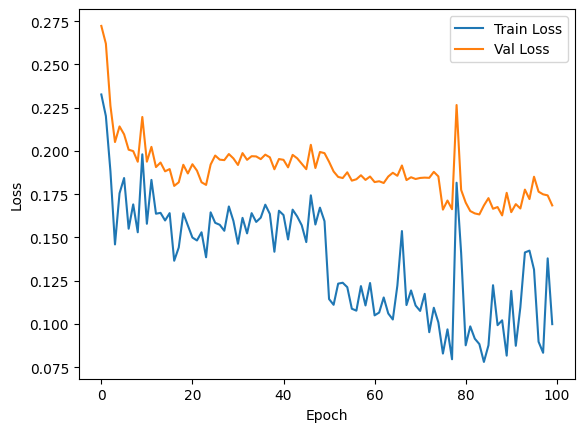

In [11]:
plt.plot(range(len(train_losses)), train_losses, label='Train Loss')
plt.plot(range(len(val_losses)), val_losses, label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [12]:
torch.save(model.state_dict(), '/content/drive/MyDrive/Models/curriculum1_residual_autoencoder_mse_cosine_lr_001.pth')

In [13]:
test_input_dir = "/content/dataset/test_black_rgb"
test_output_dir = "/content/dataset/test_color_resized"
model.eval()

test_dataset = CustomDataset(test_input_dir, test_output_dir, transform=ToTensor())
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Validation loop
total_mse_loss = 0.0
total_msssim_score = 0.0

with torch.no_grad():
    for input_image, target_image in test_dataloader:
        input_image = input_image.to(device)
        target_image = target_image.to(device)

        # Forward pass
        output_image = model(input_image)

        # Compute loss
        mse_loss = calculate_mse_loss(output_image, target_image)
        total_mse_loss += mse_loss.item()

        msssim_score = calculate_msssim_score(output_image, target_image)
        total_msssim_score += msssim_score.item()


    # Compute average loss
    avg_mse_loss = total_mse_loss / len(test_dataloader)
    avg_msssim_score = total_msssim_score / len(test_dataloader)

    print(f'Test MSE Loss: {avg_mse_loss:.4f}')
    print(f'Test MSSSIM Score: {avg_msssim_score:.4f}')

Test MSE Loss: 0.0088
Test MSSSIM Score: 0.9006
